In [ ]:
#!conda install numpy pandas matplotlib scikit-learn plotly seaborn folium geopy shapely holidays xgboost mapie -y

In [ ]:
import warnings
warnings.filterwarnings("ignore")

import os
import re

import numpy as np
import pandas as pd

import holidays

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="whitegrid")

from sklearn.cluster import KMeans

import folium
from geopy.distance import geodesic, great_circle

from folium.plugins import HeatMap

from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import make_scorer

from sklearn.model_selection import TimeSeriesSplit,GridSearchCV

from xgboost import XGBRegressor

import shap
# from SALib.sample.morris import sample
# from SALib.analyze.morris import analyze
# from SALib.test_functions import Sobol_G

from mapie.regression import MapieRegressor
from mapie.metrics import regression_coverage_score

import gc

In [ ]:
stores_df = pd.read_csv('stores.csv')
users_df = pd.read_csv('users.csv')
df = pd.read_csv('transactions.csv', parse_dates=['event_occurrence'])

In [ ]:
df = df.merge(users_df, how='left', left_on='user_id', right_on='id').merge(stores_df, how='left', left_on='store_id', right_on='id', suffixes=('_user', '_store'))
df.drop(['id_x','id_y','id'], axis=1, inplace=True)

In [ ]:
df.isna().sum()/len(df)*100

user_id              0.000000
store_id             0.000000
event_occurrence     0.000000
amount               0.000000
gender              10.129941
age                  4.844084
nam                  0.000000
laa                  0.000000
category             0.000000
lat                  0.000000
lon                  0.000000
dtype: float64

The `df` DataFrame contains transaction data merged with user and store information. Here's a brief overview of the columns present in the DataFrame:

- `user_id`: Unique identifier for users.
- `store_id`: Unique identifier for stores.
- `event_occurrence`: Datetime of the transaction.
- `amount`: The amount of the transaction in yen.
- `gender`: The gender of the user.
- `age`: The age of the user.
- `nam`: The prefecture where the store is located.
- `laa`: Local administrative area where the store is located.
- `category`: Category of the store.
- `lat`: Latitude of the store location.
- `lon`: Longitude of the store location.

In [ ]:
gmv_total = df['amount'].sum()
print(f"Total GMV: {gmv_total} Yen")

Total GMV: 2696033615 Yen


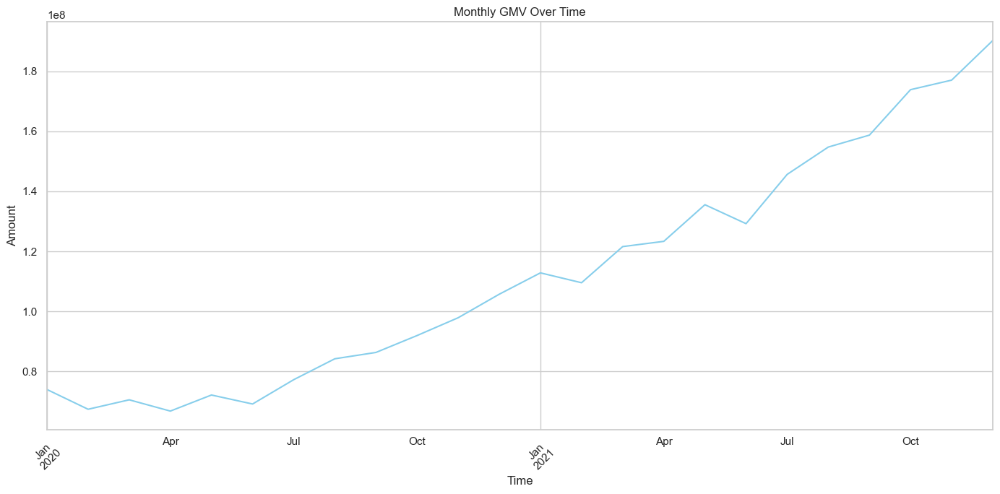

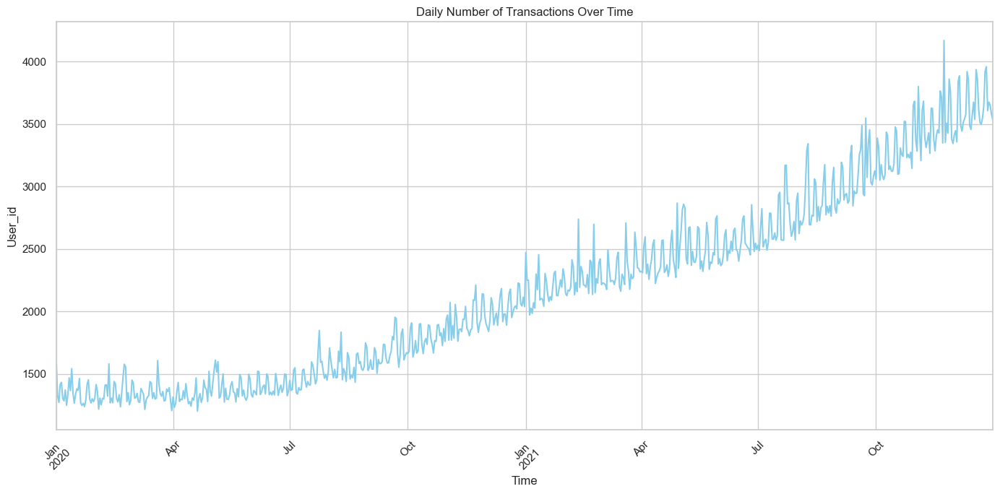

In [ ]:
def plot_transactions_over_time(df, time_freq='M', column='amount', title='Transaction Volume Over Time'):

    df['event_occurrence'] = pd.to_datetime(df['event_occurrence'])
    
    # aggregation function 
    if column == 'amount':
        agg_func = 'sum'
    else:
        agg_func = 'size'
    
    plot = df.resample(time_freq, on='event_occurrence')[column].agg(agg_func)
    
    # Plotting
    plt.figure(figsize=(14, 7))
    plot.plot(title=title, color='skyblue')
    plt.xlabel('Time')
    plt.ylabel(column.capitalize())
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

plot_transactions_over_time(df, time_freq='M', column='amount', title='Monthly GMV Over Time')
plot_transactions_over_time(df, time_freq='D', column='user_id', title='Daily Number of Transactions Over Time')

- The daily transaction show a cyclic trend over time. During Jan 2020 to April 2020 there seems to be a cyclic trend in transction but overall it remains constant around 1500, this might be because yayay just began operations in 2019 and may be onboarding new stores, users, catgoryon the platform or other factors affecting the transaction volumes.
- Althought the general trend for GMV is upwards but it does show a non montonic relation.The trend in GMV seems to be correlated with number of transactions.

In [ ]:
def calculate_gmv_by_day_type(df):
    temp_df = df.copy()
    temp_df['event_occurrence'] = pd.to_datetime(temp_df['event_occurrence'])

    # Identify weekends
    temp_df['is_weekend'] = temp_df['event_occurrence'].dt.dayofweek >= 5

    # Identify holidays
    jp_holidays = holidays.Japan(years=temp_df['event_occurrence'].dt.year.unique())
    temp_df['is_holiday'] = temp_df['event_occurrence'].dt.date.isin(jp_holidays)

    # Categorize days
    temp_df['day_type'] = temp_df.apply(lambda x: 'Holiday' if x['is_holiday'] else ('Weekend' if x['is_weekend'] else 'Weekday'), axis=1)

    # Groups by day_type and calculate total GMV, count, and standard deviation
    stats_by_day_type = temp_df.groupby('day_type').agg(
        total_gmv=('amount', 'sum'),
        count=('amount', 'count'),
        average_gmv=('amount', 'mean'),
        std_dev_gmv=('amount', 'std')
    ).reset_index()

    return stats_by_day_type
stats_by_day_type = calculate_gmv_by_day_type(df)
print(stats_by_day_type)

  day_type   total_gmv    count  average_gmv  std_dev_gmv
0  Holiday   141530963    83186  1701.379595  4108.725033
1  Weekday  1753505632  1031396  1700.128401  5174.947037
2  Weekend   800997020   467678  1712.710497  5933.108990


average GMV seems to be same across weekends,weekdays and holidays, althought the standard deviations seem to differ across all 3 day type

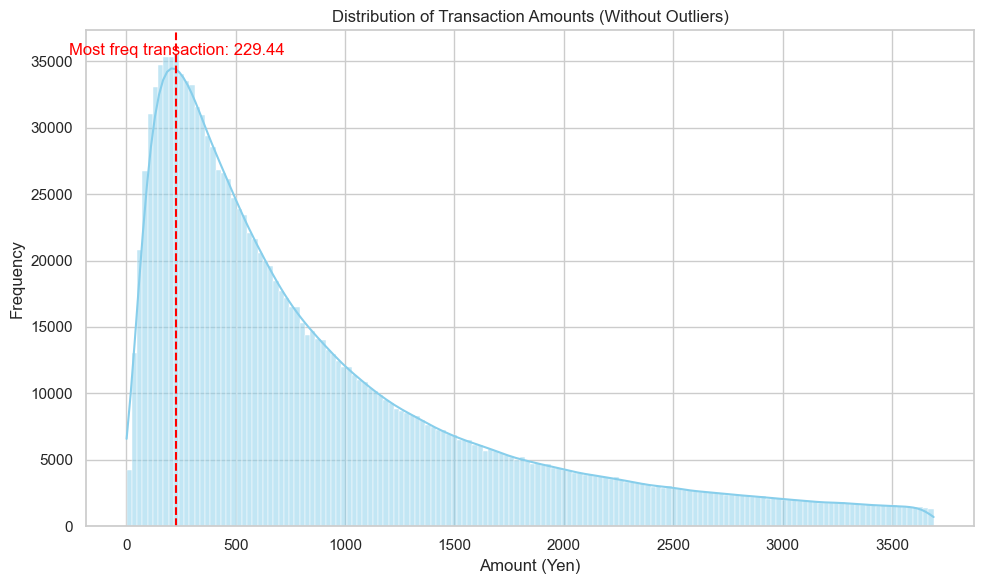

In [ ]:
def plot_filtered_transaction_distribution(df, column='amount', include_kde=False, outlier_coefficient=1.5):
  
    # Step 1: Filter out outliers
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - outlier_coefficient * IQR
    upper_bound = Q3 + outlier_coefficient * IQR

    filtered_transactions = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    
    # Step 2: Dynamically create bins for the transaction amount distribution
    bin_width = 2 * IQR * (len(filtered_transactions[column]) ** (-1/3))
    max_value = filtered_transactions[column].max()
    min_value = filtered_transactions[column].min()
    num_bins = int((max_value - min_value) / bin_width)
    
    # Plotting
    plt.figure(figsize=(10, 6))
    sns.histplot(filtered_transactions[column], bins=num_bins, kde=include_kde, color='skyblue')
    plt.title('Distribution of Transaction Amounts (Without Outliers)')
    plt.xlabel('Amount (Yen)')
    plt.ylabel('Frequency')

    # Enhancing annotations for max frequency bin
    counts, bin_edges = np.histogram(filtered_transactions[column], bins=num_bins)
    max_freq_index = np.argmax(counts)
    max_freq_bin_center = (bin_edges[max_freq_index] + bin_edges[max_freq_index + 1]) / 2
    
    plt.axvline(x=max_freq_bin_center, color='red', linestyle='--')
    plt.text(max_freq_bin_center, plt.ylim()[1] * 0.95, f'Most freq transaction: {max_freq_bin_center:.2f}', color='red', ha='center')
    
    plt.tight_layout()
    plt.show()

plot_filtered_transaction_distribution(df, 'amount', include_kde=True)

- The typical transaction size is centered around 229.44 yen with range spread from 2 to 3689 excluding the outliers, with most transactions with a large number of them below 1,000 yen, indicating that smaller transactions dominate the dataset.
- this could probably be due to people making frequent low volume transactions on evereyday items like groceries and othe convenience items, and less on expensive items like electronics etc.

In [ ]:
# Apply the category translations based on the provided output
category_translation = {
    'コンビニ': 'Convenience Store',
    'ショッピング': 'Shopping',
    'グルメ': 'Gourmet',
    'スーパーマーケット': 'Supermarket',
    'カフェ': 'Cafe',
    'その他': 'Others',
    'ファッション': 'Fashion',
    'ドラッグストア・薬局': 'Pharmacy',
    'エンタメ': 'Entertainment',
    'マッサージ': 'Massage',
    '美容院・サロン': 'Salon',
    '家電・携帯電話': 'Electronics/Mobile Phones',
    'ホテル・旅館': 'Hotel/Inn',
    '病院・クリニック': 'Hospital/Clinic',
    'クリーニング': 'Cleaning',
    '百貨店・ショッピングセンター': 'shopping center'
}

df['category'] = df['category'].map(category_translation).fillna(df['category'])

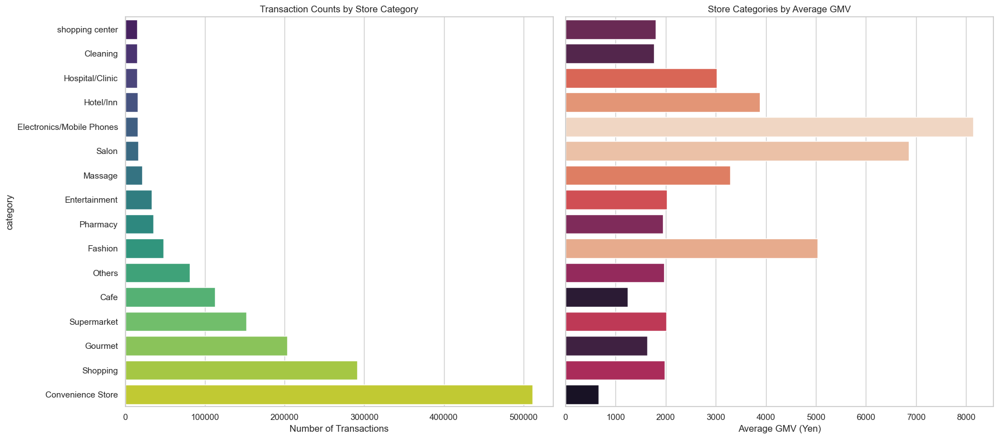

In [ ]:
def plot_category_insights(df, category_translation):
    df['category'] = df['category'].map(category_translation).fillna(df['category'])
    
    # Calculate transaction counts and total GMV by category
    transaction_counts = df['category'].value_counts()
    total_gmv = df.groupby('category')['amount'].sum()
    
    # Calculate average GMV by category
    avg_gmv = total_gmv / transaction_counts
    
    # Sort categories by transaction counts and average GMV
    sorted_categories_by_count = transaction_counts.sort_values(ascending=True)
    sorted_categories_by_avg_gmv = avg_gmv.sort_values(ascending=True)
    
    # Plotting the figures side by side
    fig, axs = plt.subplots(1, 2, figsize=(18, 8), sharey=True)
    
    # Transaction Counts by Store Category
    sns.barplot(ax=axs[0], x=sorted_categories_by_count.values, y=sorted_categories_by_count.index, palette="viridis")
    axs[0].set_title('Transaction Counts by Store Category')
    axs[0].set_xlabel('Number of Transactions')
    
    # Store Categories by Average GMV
    sns.barplot(ax=axs[1], x=sorted_categories_by_avg_gmv.values, y=sorted_categories_by_avg_gmv.index, palette="rocket")
    axs[1].set_title('Store Categories by Average GMV')
    axs[1].set_xlabel('Average GMV (Yen)')
    
    plt.tight_layout()
    plt.show()

plot_category_insights(df, category_translation)
    

- Categories like convinience stores,shopping,gourmet,cafe have a high number of transactions but a lower total GMV this is probably due to frequent lower-priced items or smaller average transaction sizes.
- Categories like electronics,salon,fashion higher GMV but fewer transactions, indicating a high value per transaction. 

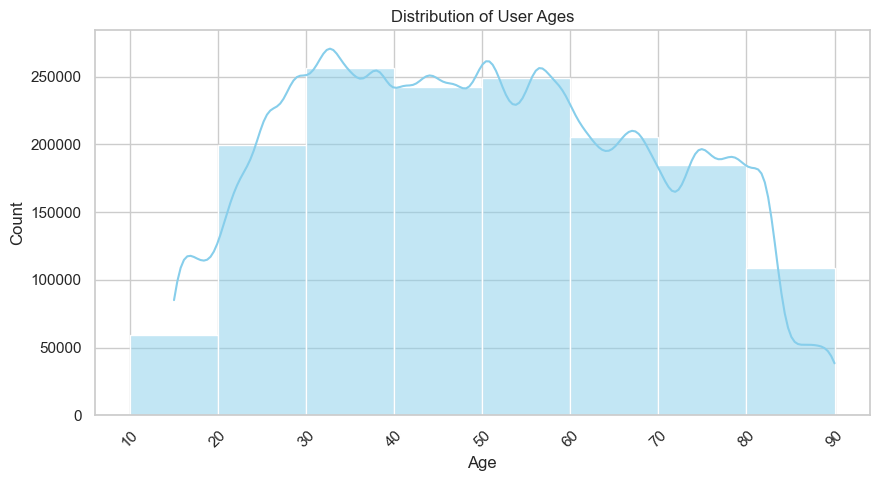

In [ ]:
def plot_age_distribution(df, age_column='age', bins=None, include_kde=True, title='Distribution of User Ages'):
    plt.figure(figsize=(10, 5))
    sns.histplot(data=df, x=age_column, bins=bins, kde=include_kde, color='skyblue')
    plt.title(title)
    plt.xlabel('Age')
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.show()

# Example usage
plot_age_distribution(df, age_column='age', bins=[10, 20, 30, 40, 50, 60, 70, 80, 90], include_kde=True)

In [ ]:
# Convert age to categorical bins
age_bins = [0, 20, 30, 40, 50, 60, 70, 80, 90, np.inf]  # Defining age bins
age_labels = ['below_20', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80-89', '90+']  
df['age_category'] = pd.cut(df['age'], bins=age_bins, labels=age_labels, right=False)

# Fill missing values in 'age_category' with a specific category for missing values
df['age_category'] = df['age_category'].cat.add_categories('Unknown').fillna('Unknown')

- A significant portion of the users fall within the mid-life age range(30-39, 50-59, and 40-49). This could imply that the platform or service is most popular among individuals who are likely to be in the midst of their careers and possibly have more disposable income.
- The relatively high percentages in the 60-69 and 70-79 age groups indicate that older adults are also a considerable user base, which might reflect the platform's accessibility or appeal to this demographic.
- The lower representation of the <20 age group suggests that younger individuals (teenagers and young adults) use the service/platform less frequently or that they are a smaller portion of the customer base.
- The "Unknown" category, which accounts for 4.84% of the data, indicates that there's a segment of users for whom age data is missing. This could point to gaps in data collection or users' reluctance to share age information.
- The smallest representation is seen in the 90+ category, which is expected as there are generally fewer individuals in this age group and they may be less engaged with the platform or service being analyzed.

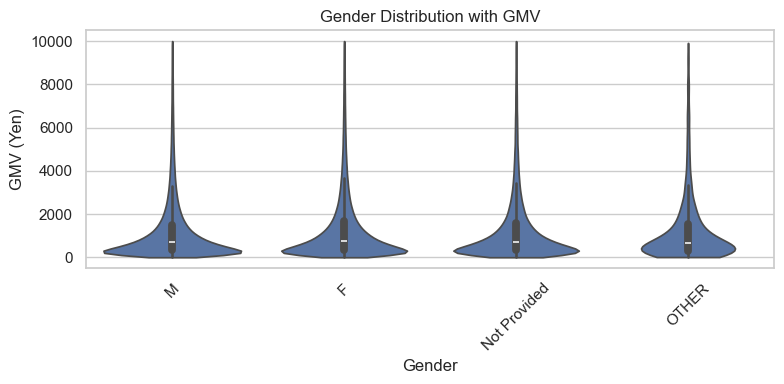

In [ ]:
def plot_gmv_by_gender(df, gmv_cap=None, fillna_value='Not Provided'):
    # Copy df to avoid in-place modifications
    temp_df = df.copy()
    
    # Fill missing gender values
    temp_df['gender'] = temp_df['gender'].fillna(fillna_value)
    
    # Apply GMV cap if specified
    if gmv_cap is not None:
        temp_df = temp_df[temp_df['amount'] <= gmv_cap]
    
    # Plotting
    plt.figure(figsize=(8, 4))
    sns.violinplot(data=temp_df, x='gender', y='amount', cut=0)
    plt.title('Gender Distribution with GMV')
    plt.xlabel('Gender')
    plt.ylabel('GMV (Yen)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Example usage
plot_gmv_by_gender(df, gmv_cap=10000)

In [ ]:
df[['category','gender']][df['amount'] > 100000].value_counts().sort_values(ascending=False)

category                   gender
Electronics/Mobile Phones  M         94
                           F         61
Fashion                    F         36
Others                     M         14
Shopping                   M         14
Others                     F         12
Hotel/Inn                  M          9
Shopping                   F          8
Fashion                    M          8
Entertainment              M          6
Supermarket                M          4
Cafe                       M          3
Hotel/Inn                  F          3
Hospital/Clinic            F          2
Massage                    F          2
                           M          2
Pharmacy                   M          1
Cafe                       F          1
Fashion                    OTHER      1
Entertainment              F          1
Hospital/Clinic            M          1
Name: count, dtype: int64

In [ ]:
df['category'][df['amount'] > 500000].value_counts()

category
Electronics/Mobile Phones    13
Others                        1
Name: count, dtype: int64

- The GMV distributions across different gender categories show a variety of median values and spreads. This might indicate differences in purchasing behavior or preferences among the different gender groups.
- high-value transactions are predominantly in the electronics/mobile phones category, which could be due to the high cost of items in this category or a preference for high-value transactions within this segment.
- Men and women equally engage in electronics,while it seems women engage more in Fashion.this could be due to seasonal offers or ads targetted towards women.
- The transaction amounts across different genders show a similar distribution, with a wide range of amounts, though the median transaction size is relatively same.

In [ ]:
def plot_proportions_by_category(df, col, p=True, include_age_bins=False, include_day_type=False):

    temp_df = df.copy()

    if col=='day_type':
        temp_df['is_weekend'] = temp_df['event_occurrence'].dt.dayofweek >= 5
        jp_holidays = holidays.Japan(years=temp_df['event_occurrence'].dt.year.unique())
        temp_df['is_holiday'] = temp_df['event_occurrence'].dt.date.isin(jp_holidays)
        temp_df['day_type'] = temp_df.apply(lambda x: 'Holiday' if x['is_holiday'] else ('Weekend' if x['is_weekend'] else 'Weekday'), axis=1)

    
    elif col=='age_category':
        age_bins = [0, 20, 30, 40, 50, 60, 70, 80, 90, np.inf]
        age_labels = ['below_20', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80-89', '90+']
        temp_df['age_category'] = pd.cut(temp_df['age'], bins=age_bins, labels=age_labels, right=False)
        temp_df['age_category'] = temp_df['age_category'].cat.add_categories('Unknown').fillna('Unknown')
        col = 'age_category' 

    # Calculate the category proportions for each category within the specified column
    category_proportions = temp_df.groupby(col)['category'].apply(
        lambda x: (x.value_counts() / temp_df['category'].value_counts())
    )
    most_significant_categories = category_proportions.groupby(level=0).nlargest(1).reset_index(level=0, drop=True)

    category_proportions_monthly = temp_df.groupby(temp_df.event_occurrence.dt.month)[col].apply(
        lambda x: (x.value_counts() / temp_df[col].value_counts())
    )
  
    if p!=False:
        print("Most Significant Categories by " + col + ":\n", most_significant_categories)

    # Set up the matplotlib figure for plotting monthly category proportions
    fig, ax = plt.subplots(figsize=(12, 8))

    # Plot the monthly category proportions for the specified column
    (category_proportions_monthly*100).unstack(level=0).T.plot(ax=ax)
    ax.set_title('Monthly Category Proportions for ' + col)
    ax.set_ylabel('Category Proportion (%)')
    ax.set_xlabel('Month')

    plt.tight_layout()
    plt.show()

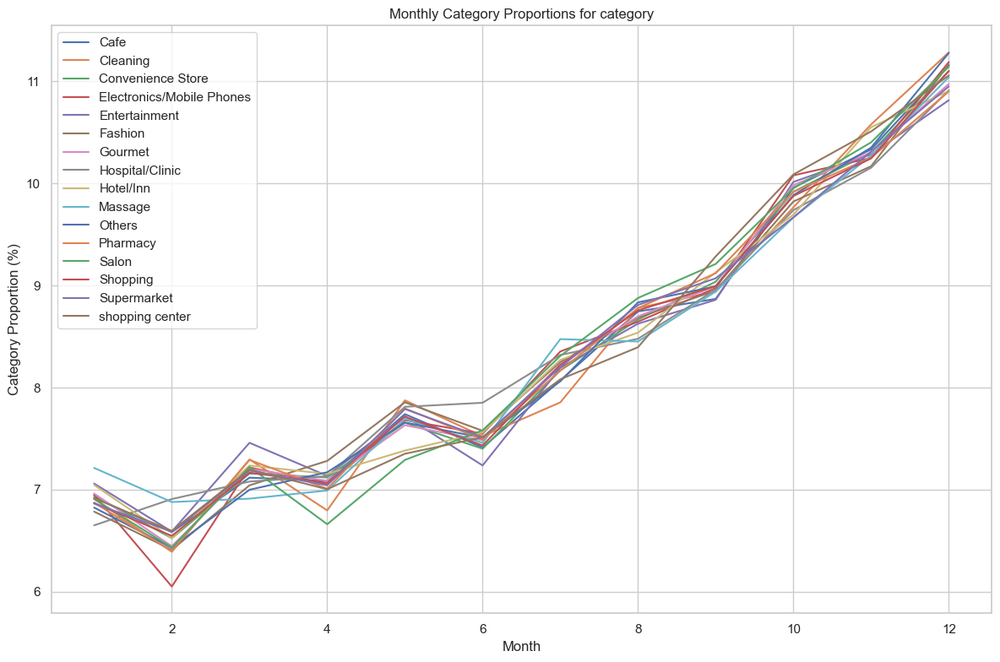

Most Significant Categories by age_category:
 age_category                 
below_20      Others             0.038578
20-29         Fashion            0.131541
30-39         Massage            0.170167
40-49         shopping center    0.160088
50-59         Pharmacy           0.163528
60-69         Hotel/Inn          0.136237
70-79         Pharmacy           0.117909
80-89         Hospital/Clinic    0.068752
90+           Cleaning           0.005259
Unknown       shopping center    0.050508
Name: category, dtype: float64


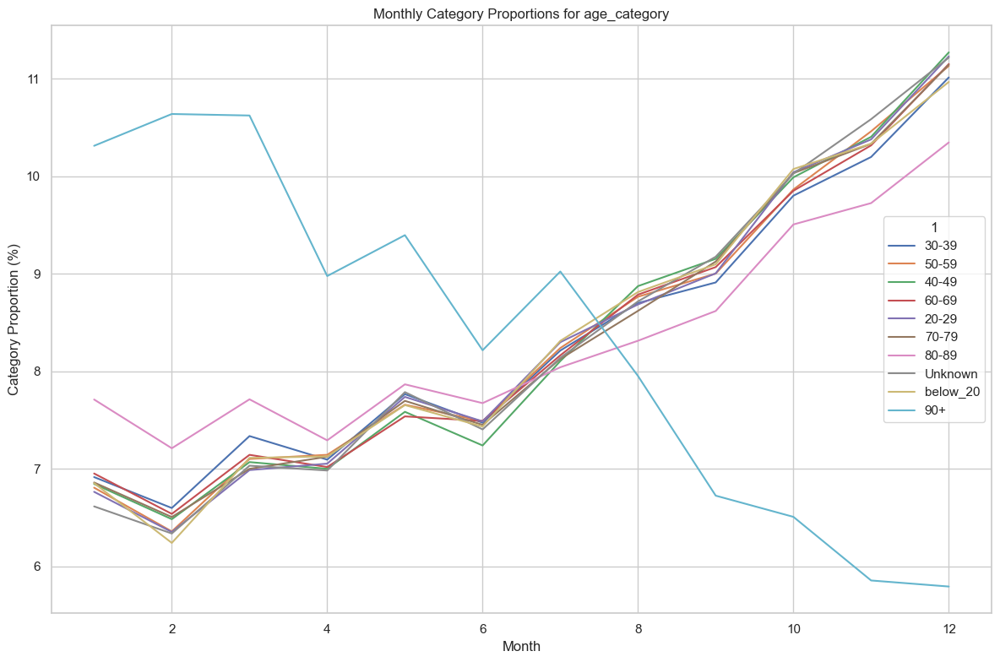

Most Significant Categories by gender:
 gender          
F       Fashion     0.723740
M       Pharmacy    0.733039
OTHER   Cleaning    0.002130
Name: category, dtype: float64


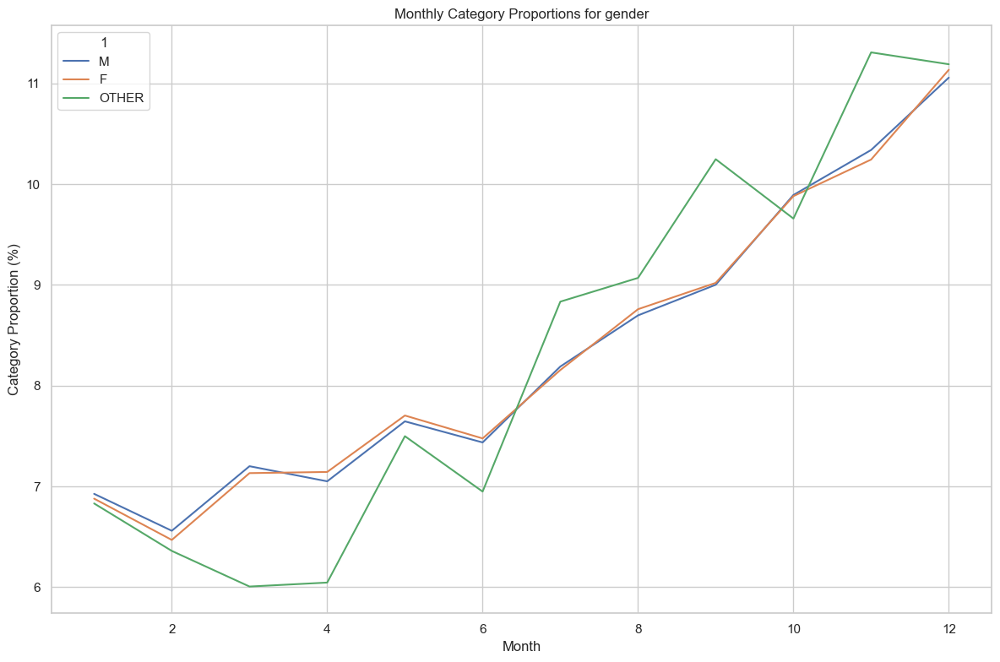

Most Significant Categories by day_type:
 day_type                           
Holiday   shopping center              0.056529
Weekday   Electronics/Mobile Phones    0.653473
Weekend   Fashion                      0.299388
Name: category, dtype: float64


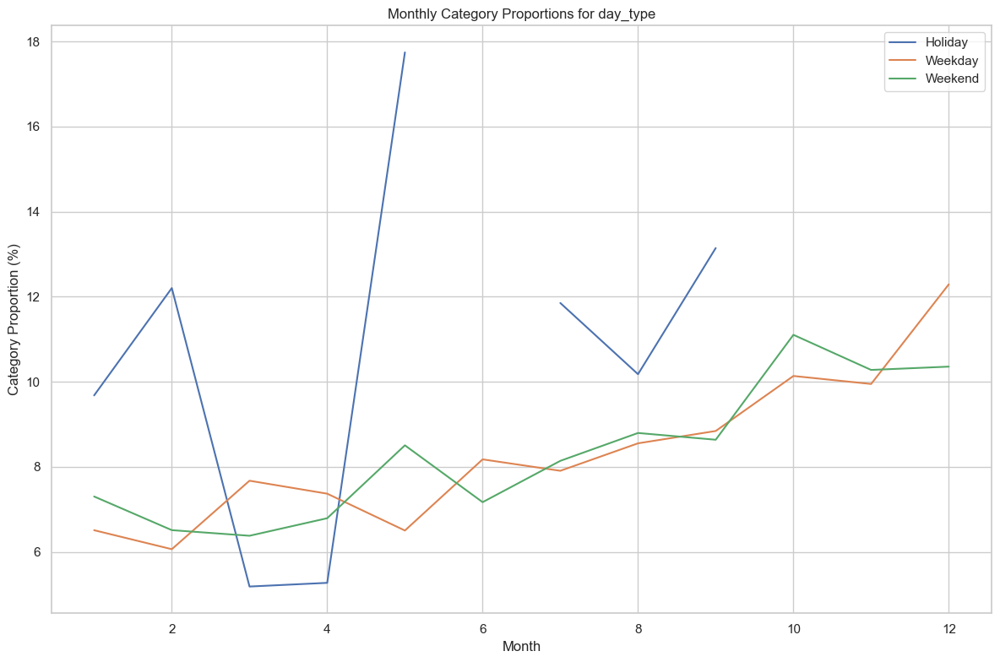

In [ ]:
plot_proportions_by_category(df, col='category',p=False)
plot_proportions_by_category(df, col='age_category')
plot_proportions_by_category(df, col='gender')
plot_proportions_by_category(df, col='day_type')

**Category propotions over time**:

- Convenience Store and Pharmacy categories show relatively stable proportions over the months, indicating a consistent patronage and possibly essential nature of these services.
- Fashion and Others categories also appear to maintain a steady presence, suggesting a constant demand.
- Entertainment and Supermarket categories exhibit some fluctuations, which could be attributed to seasonal variations, promotional events, or changing consumer preferences.
- Shopping and Gourmet show noticeable variations, potentially reflecting holiday seasons, special offers, or changing trend


**Gender propotions(wrt categories)**:

- the general trend between genders are consistent
- The most significant category among females is Fashion as we thought earlier.
- Pharmacy is the most significant category, indicating a higher inclination towards purchasing pharmaceutical products.
- Cleaning category is most highlighted amoung others.


**Age-categories propotions(wrt categories)**:

- Younger age groups ("<20", "20-29") spend a significant proportion in categories like Others and Fashion,mantaining a consistent trend across the months.
- Middle age groups ("30-39", "40-49", "50-59"), show fluctuation over time and prefer to spend on categories like Massage, Shopping Center, and Pharmacy, suggesting a focus on wellness, shopping, and health.
- Older age groups (60-69, 70-79, 80-89, 90+) appear to maintain a general trend and are inclined towards Hotel/Inn, Pharmacy, Hospital/Clinic, and Cleaning. Possibly reflecting holiday traveling peaks, seasonal health needs, or regular medical check-ups .

**holiday propotions(wrt categories)**:
- GMV increases during holiday season like Jan-Feb,April-May,August September but the most significant category remains to be shopping center
- GMV almost remains constant during weekday and weekends, with weekends dominating but this trend changes during the weekend.
- Most Significant Categories during holidays remain to be shopping center, on weekdays to be Electronics/Mobile Phones and weekend to be fashion

In [ ]:
def create_heatmap(df, sample_frac=0.6, zoom_start=5, gradient=None, radius=10, value_col=None):
    # Sample the DataFrame
    sampled_data = df.sample(frac=sample_frac)

    # Calculate median latitude and longitude for map centering
    median_lat = sampled_data['lat'].median()
    median_lon = sampled_data['lon'].median()

    # Create the map centered around the median latitude and longitude
    map = folium.Map(location=[median_lat, median_lon], zoom_start=zoom_start)

    # Default gradient if none provided
    if gradient is None:
        gradient = {0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}

    # Prepare data for the heatmap
    if value_col and value_col in df.columns:
        heat_data = sampled_data[['lat', 'lon', value_col]].dropna()
        heat_data = [[row['lat'], row['lon'], row[value_col]] for index, row in heat_data.iterrows()]
    else:
        heat_data = sampled_data[['lat', 'lon']].dropna()
        heat_data = [[row['lat'], row['lon']] for index, row in heat_data.iterrows()]

    # Add a heat map layer to the map
    HeatMap(heat_data, gradient=gradient, radius=radius).add_to(map)

    return map
map = create_heatmap(df)
map

- Most stores transctions seems to be around Tokyo,yokohama region
- Other popular Kyoto,Sapporo,Hokkaido,Fukushima etc. seems to have dense amount of stores as well
- The above function can also be used to visualize demographies and other variables `create_heatmap(df,age)`, incase you  wish to use it

In [ ]:
def plot_laa_metrics(df, metric='count', figsize=(10, 6)):
  
    # Plotting top 20 LAAs by GMV or Transaction Counts
    agg_func = 'sum' if metric == 'sum' else 'count'
    title_suffix = 'GMV' if metric == 'sum' else 'Transaction Count'
    df.groupby('laa')['amount'].agg(agg_func).sort_values(ascending=False).head(20).plot(kind='bar', figsize=figsize)
    plt.title(f'Top 20 LAAs by {title_suffix}')
    plt.ylabel(f'Total {title_suffix} in Yen' if metric == 'sum' else 'Transaction Counts')
    plt.xlabel('Local Administrative Area')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    # Heatmap for Transaction Metrics by LAA and Category
    transaction_metrics = df.groupby(['nam', 'category'])['amount'].agg(agg_func).reset_index(name='metrics')
    pivot_table = transaction_metrics.pivot(index="nam", columns="category", values="metrics").fillna(0)
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(pivot_table, cmap="YlGnBu", linewidths=0.05, fmt=".0f")
    plt.title(f'{title_suffix} by LAA and Category', fontsize=16)
    plt.ylabel('Local Administrative Area', fontsize=14)
    plt.xlabel('Category', fontsize=14)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

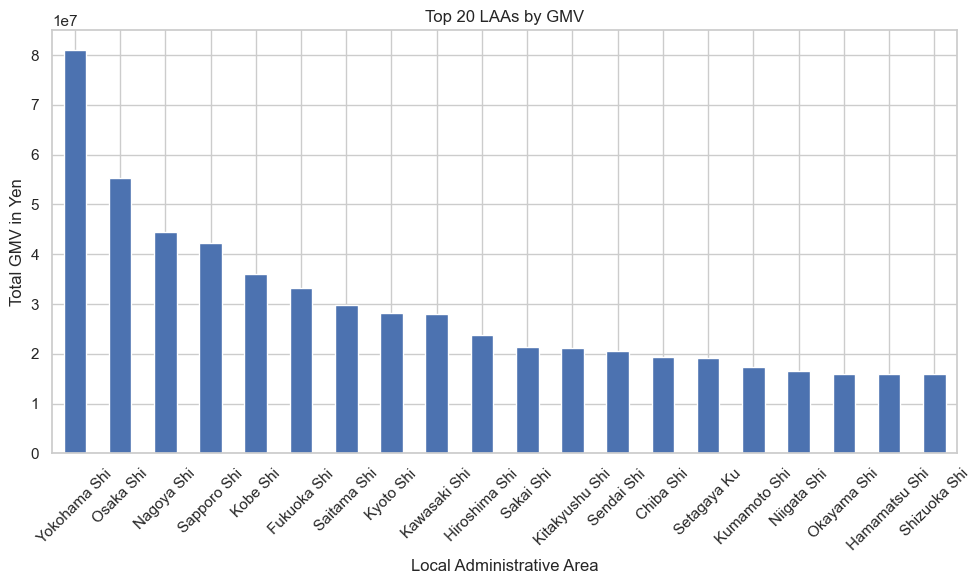

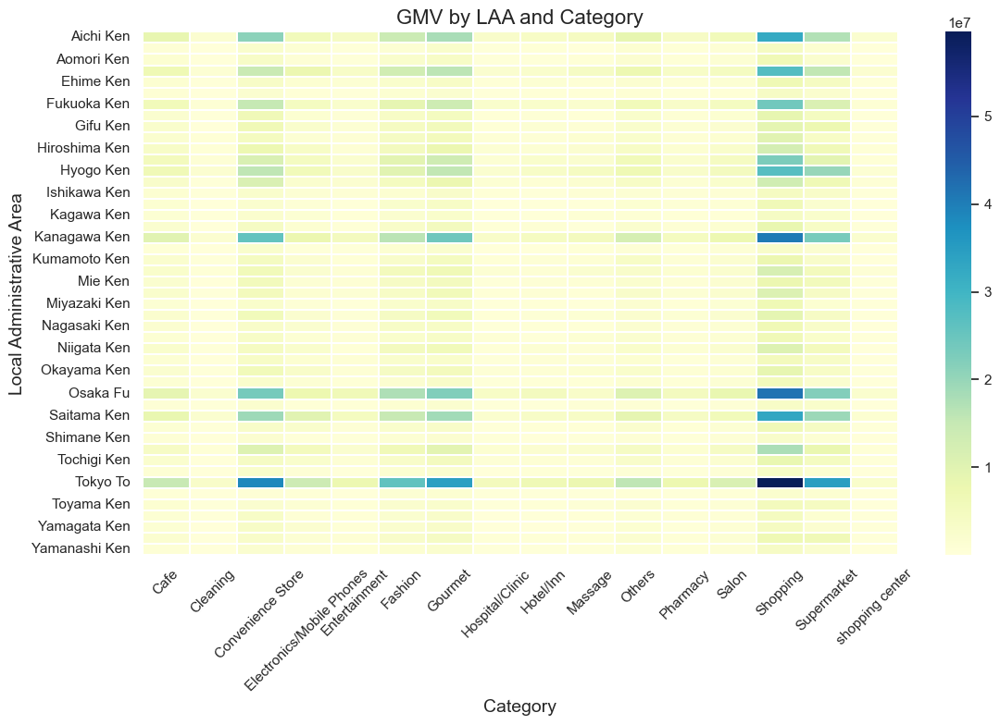

In [ ]:
plot_laa_metrics(df, metric='sum')  # For GMV

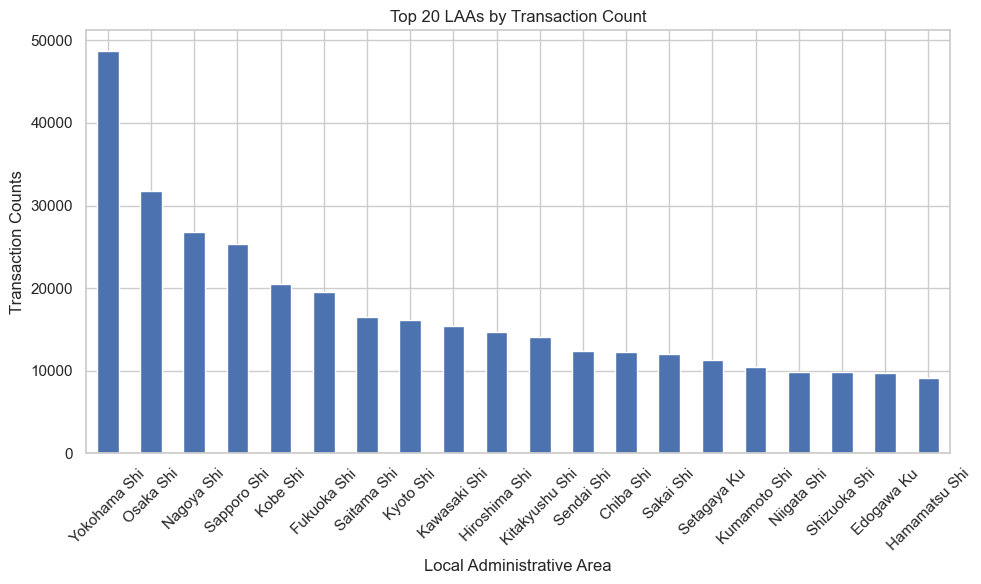

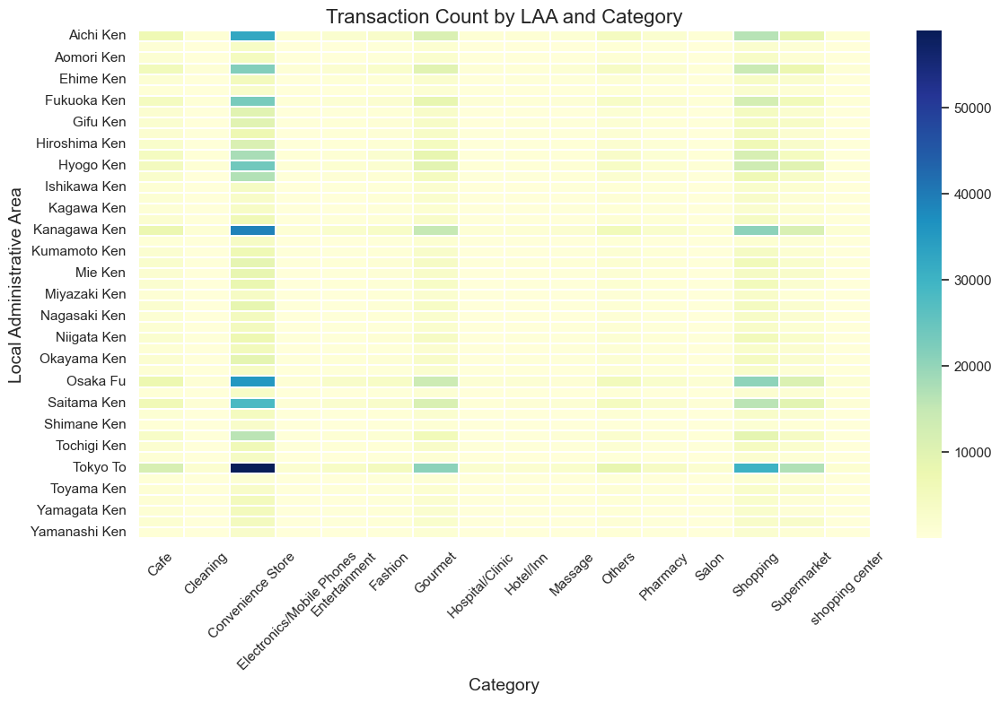

In [ ]:
plot_laa_metrics(df, metric='count')  # For transaction count

- Total GMV in top locations shows no correlation with average GMV but correlates more with the number of transactions, suggesting multiple smaller transactions drive output across locations.
- Dominant categories in top locations include electronics/mobile and salon, correlating with higher-cost transactions.
- Average and total GMV across categories in top locations exhibit similar behavior, with electronics having higher average GMV but shopping having higher total GMV.
- Demographics in top locations show similar behavior in average and total GMV across categories. 

### Feature Engineering and Preparing Dataset for Forecasting

Based on EDA, lets develop some features-

1. distance travelled by user when making multiple transcations during a day. 
2. calculate ranks based on GMV performance for past month and ranks based on popularity amoung user last month.
3. one hot encode categories,gender.
4. bin age into age_categories and nominal encode them.
5. `txn_day`,`txn_night`, `is_weekday` ,`is_weekend` and `is_holiday` flags to capture spending and transaction behaviour on these days.

In [ ]:
def preprocess_data(df, stores_df, users_df):
    # Merge dataframes
    df = df.merge(users_df, how='left', left_on='user_id', right_on='id').merge(
        stores_df, how='left', left_on='store_id', right_on='id', suffixes=('_user', '_store'))
    df.drop(['id_x', 'id_y', 'id'], axis=1, inplace=True)

    # Apply category translations
    category_translation = {
        'コンビニ': 'Convenience Store',
        'ショッピング': 'Shopping',
        'グルメ': 'Gourmet',
        'スーパーマーケット': 'Supermarket',
        'カフェ': 'Cafe',
        'その他': 'Others',
        'ファッション': 'Fashion',
        'ドラッグストア・薬局': 'Pharmacy',
        'エンタメ': 'Entertainment',
        'マッサージ': 'Massage',
        '美容院・サロン': 'Salon',
        '家電・携帯電話': 'Electronics/Mobile Phones',
        'ホテル・旅館': 'Hotel/Inn',
        '病院・クリニック': 'Hospital/Clinic',
        'クリーニング': 'Cleaning',
        '百貨店・ショッピングセンター': 'Shopping Center'
    }
    df['category'] = df['category'].map(category_translation).fillna(df['category'])

    # Get dummy variables for gender and categories
    df['gender'] = df['gender'].fillna('Not Provided')
    df = pd.get_dummies(df, columns=['category', 'gender'])

    # Create age bins and ordinally encode them
    age_bins = [0, 20, 30, 40, 50, 60, 70, 80, np.inf,]
    age_labels = ['below_20', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80+']
    df['age_category'] = pd.cut(df['age'], bins=age_bins, labels=age_labels, right=False)
    df['age_category'] = df['age_category'].cat.add_categories('Unknown').fillna('Unknown')
    age_group_mapping = {
        'below_20': 0, '20-29': 1, '30-39': 2, '40-49': 3,
        '50-59': 4, '60-69': 5, '70-79': 6, '80+': 7,
        'Unknown': -1
    }
    df['age_category'] = df['age_category'].map(age_group_mapping).astype(int)

    # Capture transaction time
    df['txn_day'] = df['event_occurrence'].dt.hour.between(6, 18).astype(int)  # Daytime transactions
    df['txn_night'] = (df['event_occurrence'].dt.hour < 6) | (df['event_occurrence'].dt.hour >= 18).astype(int)  # Nighttime transactions
    df.drop(['age'], axis=1, inplace=True)
    return df
    
#distance travelled by user since last transaction on the same day

def calculate_travel_distances(df):
    # Sort by user_id and event_occurrence
    df.sort_values(by=['user_id', 'event_occurrence'], inplace=True)
    
    # Calculate previous latitude and longitude for each user
    prev_lat = df.groupby('user_id')['lat'].shift(1)
    prev_lon = df.groupby('user_id')['lon'].shift(1)
    
    # Calculate distance traveled for transactions on the same day
    same_day = df.groupby('user_id')['event_occurrence'].diff().fillna(pd.Timedelta(seconds=0)) <= pd.Timedelta(days=1)
    mask = prev_lat.notna() & same_day
    df.loc[mask, 'distance'] = df[mask].apply(
        lambda row: geodesic((prev_lat[row.name], prev_lon[row.name]), (row['lat'], row['lon'])).kilometers, axis=1
    )
    
    # Fill NaN values with 0 distance
    df['distance'] = df['distance'].fillna(0)
    df.drop(['lat', 'lon'], axis=1, inplace=True)
    return df

def calculate_store_ranks(df, group_columns, value_column, rank_suffix):
    df['event_occurrence'] = pd.to_datetime(df['event_occurrence'])
    df_temp = df.copy()
    df_temp['year_month'] = df_temp['event_occurrence'].dt.to_period('M')
    
    # Aggregate value by specified columns and month
    if value_column == 'user_id':
        aggregated_data = df_temp.groupby(group_columns + ['year_month'])[value_column].count().reset_index(name='monthly_value')
    else:
        aggregated_data = df_temp.groupby(group_columns + ['year_month'])[value_column].sum().reset_index(name='monthly_value')
    
    # Rank values within each group and month
    rank_columns = [f'rank_{group_column}{rank_suffix}' for group_column in group_columns]
    rank_columns.append(f'rank_overall{rank_suffix}')
    
    for group_column in group_columns:
        aggregated_data[f'rank_{group_column}{rank_suffix}'] = aggregated_data.groupby([group_column, 'year_month'])['monthly_value'].rank("dense", ascending=False)
    
    return aggregated_data.drop('monthly_value', axis=1)

def calculate_store_ranks_gmv(df):
    return calculate_store_ranks(df, ['store_id','laa', 'nam'], 'amount', '_gmv')

def calculate_store_ranks_popularity(df):
    return calculate_store_ranks(df, ['store_id','laa', 'nam'], 'user_id', '_popularity')

def shift_columns_by_month(df, columns_to_shift):
    df['year_month'] = df['event_occurrence'].dt.to_period('M')
    df[columns_to_shift] = df.groupby(['store_id', 'year_month'])[columns_to_shift].shift(periods=1).fillna(9999)
    df.drop(['nam', 'laa', 'year_month'], axis=1, inplace=True)
    return df

In [ ]:
stores_df = pd.read_csv('stores.csv')
users_df = pd.read_csv('users.csv')
df = pd.read_csv('transactions.csv', parse_dates=['event_occurrence'])

df = preprocess_data(df, stores_df, users_df)

df = calculate_travel_distances(df)

# calculate store ranks and popularilty
store_ranks_gmv = calculate_store_ranks_gmv(df)
store_popularity_user = calculate_store_ranks_popularity(df)
df['year_month'] = df['event_occurrence'].dt.to_period('M')
df = pd.merge(df, store_ranks_gmv, on=['store_id', 'laa', 'nam', 'year_month'], how='left')
df = pd.merge(df, store_popularity_user, on=['store_id', 'laa', 'nam', 'year_month'], how='left')

#shift populaity to next month to avoid data leak
columns_to_shift = df.filter(regex=r'^rank_.*').columns
df = shift_columns_by_month(df, columns_to_shift)

We plan on using 30 days as our forecast horizion for user forecast and Yayay as whole, therefore we would need to check if all dates with freqeuncy of `'1D'` exists from `2020-01-01` to `2021-12-30` exist and apply the grouping accordingly

In [ ]:
df['event_occurrence'] = pd.to_datetime(df['event_occurrence'])
all_dates = pd.date_range(df['event_occurrence'].min(), df['event_occurrence'].max(), freq='1D')
missing_dates = all_dates.difference(pd.DatetimeIndex(df['event_occurrence'].dt.date.unique()))

print("The DataFrame contains all dates within the specified range.") if missing_dates.empty else print(f'The DataFrame is missing {len(missing_dates.date.tolist())} dates')

The DataFrame is missing 731 dates


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1582260 entries, 0 to 1582259
Data columns (total 34 columns):
 #   Column                              Non-Null Count    Dtype         
---  ------                              --------------    -----         
 0   user_id                             1582260 non-null  object        
 1   store_id                            1582260 non-null  object        
 2   event_occurrence                    1582260 non-null  datetime64[ns]
 3   amount                              1582260 non-null  int64         
 4   category_Cafe                       1582260 non-null  bool          
 5   category_Cleaning                   1582260 non-null  bool          
 6   category_Convenience Store          1582260 non-null  bool          
 7   category_Electronics/Mobile Phones  1582260 non-null  bool          
 8   category_Entertainment              1582260 non-null  bool          
 9   category_Fashion                    1582260 non-null  bool          

preparing `df_user` for user forecast, here we group user and `event_occurrence`, then reindex the grouped datatframe from date from 2020-01-01 to 2020-30-12 and impute the missing values accordingly

In [ ]:
def aggregate_user_data(df):
    df_user = df.groupby(['user_id', df.event_occurrence.dt.date]).agg({
        'amount': 'sum',
        **{col: 'first' for col in df.filter(regex=r'^gender_').columns},
        **{col: 'sum' for col in df.filter(regex=r'^category_').columns},
        'age_category': 'first',
        'distance': 'sum',
        'txn_day': 'sum',
        'txn_night': 'sum'
    })
    
    all_dates = pd.date_range(start=df_user.index.get_level_values('event_occurrence').min(), end=df_user.index.get_level_values('event_occurrence').max(), freq='1D')
    
    # Reindex the DataFrame iteratively for each user_id
    reindexed_dfs = []
    for user_id, group in df_user.groupby(level=0):
        reindexed_group = group.reindex(pd.MultiIndex.from_product([[user_id], all_dates], names=['user_id', 'event_occurrence']))
        reindexed_dfs.append(reindexed_group)
    
    # Concatenate the reindexed DataFrames
    df_user = pd.concat(reindexed_dfs)
    
    # Fill missing values with 0 for categories,txn_night,distance,amount, where no transaction occured
    columns_gmv = df_user.filter(regex=r'^category_').columns.tolist() + ['txn_night', 'txn_day', 'distance','amount']
    df_user[columns_gmv] = df_user[columns_gmv].fillna(0)
    
    # Summing gmv columns over the time period of month to capture monthly gmv
    df_user.reset_index(inplace=True) 
    df_user['event_occurrence'] = pd.to_datetime(df_user['event_occurrence'])  
    df_user.set_index('event_occurrence', inplace=True)  
    
    monthly_gmv = df_user.groupby(['user_id', pd.Grouper(freq='M')])[columns_gmv].cumsum()
    
    # Concatenating the cumulative sum back to the original DataFrame
    df_user[columns_gmv] = monthly_gmv
    
    #rename gmv
    df_user.rename(columns={'amount': 'gmv'}, inplace=True)
    
    #imputing other columns
    columns_same = df_user.filter(regex=r'^gender_').columns.tolist() + ['age_category']
    df_user[columns_same] = df_user.groupby('user_id')[columns_same].ffill().bfill()
    # Reset index to remove the MultiIndex
    df_user.reset_index(inplace=True)
    df_user['event_occurrence'] = pd.to_datetime(df_user['event_occurrence']) 

    # adding month to df
    df_user['month'] = df_user['event_occurrence'].dt.month  
    #flags for weekend and holiday,if both are 0 it means its a weekday
    df_user['is_weekend'] = df_user['event_occurrence'].dt.dayofweek >= 5
    jp_holidays = holidays.Japan(years=df_user['event_occurrence'].dt.year.unique())
    df_user['is_holiday'] = df_user['event_occurrence'].dt.date.isin(jp_holidays)
    df_user['is_weekday'] = ~(df_user['is_weekend'] | df_user['is_holiday'])

    return df_user

the above dataframe represents transactions of 9542 users for the time period between 2020-01-01 to 2021-30-12,each users gmv is calculated for each day and cumalatively summed over a particular month.we will use this to forecast it for each day of the month jan-2022. and give last day as forecasted gmv

**Example**

if a user makes a transaction of amount 15 in 2020-01-01 and another transaction as 16 in 2020-01-02 an then he only makes transaction in the next month ie 17 on 2020-02-02. The GMV on 2020-01-01 becomes 15, for 2020-01-02 it becomes 31 and continues to be the same uptill 2020-01-31 as no transaction is made and then resets so on 2020-02-02 gmv becomes 17, rest of the gmv columns are imputed in simmilar way.

preparing `df_all` for Yayay level forecast

In [ ]:
def aggregate_yayay_data(df):
    # function aggregate the df to give all transactions
    df_all = df.groupby(['store_id', 'user_id', df.event_occurrence.dt.date]).agg({
        'amount': 'sum',
        **{col: 'first' for col in df.filter(regex=r'^(gender_)').columns},
        **{col: 'min' for col in df.filter(regex=r'^(rank_)').columns},
        **{col: 'sum' for col in df.filter(regex=r'^category_').columns},
        'age_category': 'first',
        'distance': 'sum',
        'txn_day': 'sum',
        'txn_night': 'sum'
    }).reset_index()
    
    df_all['event_occurrence'] = pd.to_datetime(df_all['event_occurrence'])
    
    # Fill missing transactions to ensure each date has 4153 entries
    max_txns = df_all['event_occurrence'].dt.date.value_counts().max()
    all_dates = pd.date_range(start=df_all['event_occurrence'].dt.date.min(), 
                              end=df_all['event_occurrence'].dt.date.max(), freq='1D')

    # function to impute the missing transactions which is = max transaction that occured during that day
    # Initialize an empty DataFrame to hold the expanded transactions
    df_expanded = pd.DataFrame()
    
    for date in all_dates:
        # Filter transactions for the current date
        daily_txns = df_all[df_all['event_occurrence'].dt.date == date.date()]
        missing_rows = max_txns - daily_txns.shape[0]
        
        # If there are missing transactions for this day, add the necessary rows
        if missing_rows > 0:
            additional_rows = pd.DataFrame({col: np.nan for col in df_all.columns}, index=np.arange(missing_rows))
            additional_rows['event_occurrence'] = pd.to_datetime(date)  
            daily_txns = pd.concat([daily_txns, additional_rows], ignore_index=True)
        
        df_expanded = pd.concat([df_expanded, daily_txns], ignore_index=True)
    
    # Assign the expanded DataFrame back to df_all
    df_all = df_expanded
    
    # Fill missing values with 0 for categories, txn, distance, and amount variables
    columns_gmv = df_all.filter(regex=r'^category_').columns.tolist() + ['txn_night', 'txn_day', 'distance', 'amount']
    df_all[columns_gmv] = df_all[columns_gmv].fillna(0)

    #setting index to datetype
    df_all = df_all.reset_index()  
    df_all['event_occurrence'] = pd.to_datetime(df_all['event_occurrence'])  
    df_all.set_index('event_occurrence', inplace=True) 

    # Summing gmv columns over the time period of month to capture monthly gmv
    monthly_gmv = df_all.groupby(['store_id', 'user_id', pd.Grouper(freq='M')])[columns_gmv].cumsum()
    
    #rename nan to dummy id for consistency
    df_all[['user_id','store_id']]= df_all[['user_id','store_id']].fillna('dummy_id')
    
    # Concatenating the cumulative sum back to the original DataFrame
    df_all[columns_gmv] = monthly_gmv
    
    #rename gmv
    df_all.rename(columns={'amount': 'gmv'}, inplace=True)
    df_all['gmv']= df_all['gmv'].fillna(0)
    
    # correcting the dtype after concatenation
    columns_gender = df_all.filter(regex=r'^gender_').columns.tolist() 
    df_all[columns_gender] = df_all[columns_gender].fillna(False).astype(bool, errors='ignore')
    df_all['age_category']= df_all['age_category'].astype(int, errors='ignore')
    columns_store = df_all.filter(regex=r'^(rank_)').columns.tolist()
    df_all[columns_store] = df_all[columns_store].astype(int, errors='ignore')
    
    # Reset index to remove the MultiIndex
    df_all.reset_index(inplace=True)
    df_all['event_occurrence'] = pd.to_datetime(df_all['event_occurrence']) 
    
    #flags for weekend and holiday,if both are 0 it means its a weekday
    df_all['month'] = df_all['event_occurrence'].dt.month  
    df_all['is_weekend'] = df_all['event_occurrence'].dt.dayofweek >= 5
    jp_holidays = holidays.Japan(years=df_all['event_occurrence'].dt.year.unique())
    df_all['is_holiday'] = df_all['event_occurrence'].dt.date.isin(jp_holidays)
    df_all['is_weekday'] = ~(df_all['is_weekend'] | df_all['is_holiday'])

    return df_all.drop('index',axis=1,inplace=True)

the above dataframe represents GMV for each transaction occuring for the time period 2020-01-01 to 2021-30-12 on Yayay platform.The gmv for each transaction is calculated for each day summed over a particular month and aggregated to give the result of monthly GMV.

**consideration**

I consider store and user to be 1 transaction.I did this as we had multiple user and multiple store so total combination would have been 200000+.Instead I choose to see what would be the max number of transactions in a day,which came to be 4157(max_txns). Therefore i created a dummy user and dummy store id for non existent transaction which is equal to max_txns - daily_txns.shape[0]. the imputaions here happen in simmilar way, also gmv = 0 for dummy transaction

In [ ]:
df_user = aggregate_user_data(df)
df_all = aggregate_yayay_data(df)

In [ ]:
#function to optimize the dtypes
def optimize_dtypes(df):
    optimized_df = df.copy()
    
    # Iterate over columns
    for col in optimized_df.columns:
        col_type = optimized_df[col].dtype
        
        # Convert object columns to categorical if unique values are less than 50% of total
        if col_type == 'object' and len(optimized_df[col].unique()) / len(optimized_df[col]) < 0.5:
            optimized_df[col] = optimized_df[col].astype('category')
        
        # Convert int columns to smaller integer types if possible
        elif col_type == 'int':
            if optimized_df[col].min() >= 0:
                if optimized_df[col].max() < 255:
                    optimized_df[col] = optimized_df[col].astype('uint8')
                elif optimized_df[col].max() < 65535:
                    optimized_df[col] = optimized_df[col].astype('uint16')
                elif optimized_df[col].max() < 4294967295:
                    optimized_df[col] = optimized_df[col].astype('uint32')
                else:
                    optimized_df[col] = optimized_df[col].astype('uint64')
            else:
                if optimized_df[col].min() > -128 and optimized_df[col].max() < 127:
                    optimized_df[col] = optimized_df[col].astype('int8')
                elif optimized_df[col].min() > -32768 and optimized_df[col].max() < 32767:
                    optimized_df[col] = optimized_df[col].astype('int16')
                elif optimized_df[col].min() > -2147483648 and optimized_df[col].max() < 2147483647:
                    optimized_df[col] = optimized_df[col].astype('int32')
                else:
                    optimized_df[col] = optimized_df[col].astype('int64')
        
        # Convert float columns to smaller float types if possible
        elif col_type == 'float':
            if optimized_df[col].isnull().any():
                optimized_df[col] = optimized_df[col].astype('float32')
            elif optimized_df[col].min() >= -3.4e38 and optimized_df[col].max() <= 3.4e38:
                optimized_df[col] = optimized_df[col].astype('float32')
            else:
                optimized_df[col] = optimized_df[col].astype('float64')
    
    return optimized_df

In [ ]:
df_all = optimize_dtypes(df_all)
df_user = optimize_dtypes(df_user)

### Building Forecasting Model 

- For forecasting here I have decided to go with a bosting model XGboost 

   - Simple models like SARIMAX because and my require tuning of model orders (p, d, q) and seasonal orders (P, D, Q).It may struggle with complex, non-linear patterns or datasets with irregularities.Our data shows much variation of GMV across categories, stores, LAA etc 
   - Complex models like LSTM and RNN may be able to capture sequential and long-term patterns in time series, but are compute expensive and might require to much space given the size of our data.
    - Gradient boosting XGBoost is a viable option here as it requires less manual tuning compared to other models discussed here and can automatically handle feature interactions and learn optimal splits.
    - In real world scenarios, we could explore multiple models and compare them on real world metrics as well as different loss functions
- here we will consider mse and smape(as it is more robust in presence of outlier for simplicity. we can also include custom metrics like `loss = np.where(mape < 100, error, (error - 100) * 2 + 100) # double penalty for errors larger than 100` but this might be specific to business teams and may require more discussion with business teams.We will use shap to visualise how our model is behaving,it may be learning noise
- for feature selection there there are various ways(ranking filter methods,correlation methods, domain expertise, elimination methods, etc) but it may not work well with our dataframe, given the complexity of our aggregation and imputations.
- to address the above points,it will be important to quantify uncertainty before feature elimination.
- to understand model's limitation we will apply uncertaintity quantification method conformal prediction(extrinsic) and quantile regression(intinsic)

In [ ]:
rand = 42
os.environ['PYTHONHASHSEED']=str(rand)
np.random.seed(rand)

In [ ]:
# df_user.to_csv('df_user.csv', index=False)
# df_all.to_csv('df_all.csv', index=False)
# df_user=pd.read_csv('df_user.csv',parse_dates= ['event_occurrence'])
# df_all=pd.read_csv('df_all.csv',parse_dates= ['event_occurrence'])
# df_all.drop('index',axis=1 ,inplace=True)

In [ ]:
uc = df_user['user_id'].nunique()  # lenght of user in dataframe
tc = df_all['event_occurrence'].value_counts().max()  # max number transactions on yay

#dropping user_id and store_id
df_user = df_user.set_index('event_occurrence').sort_index().drop('user_id',axis=1)
df_all = df_all.set_index('event_occurrence').sort_index().drop(['user_id','store_id'],axis=1)

# 700 days in train, 31 days in test for each user
Train_user = df_user.iloc[:-31 * uc]
Test_user = df_user.iloc[-31 * uc:]

# 700 days in train, 31 days in test for each transaction
Train_all = df_all.iloc[:-31 * tc]
Test_all = df_all.iloc[-31 * tc:]

### Visualizing test and Training data

#### user dataframe

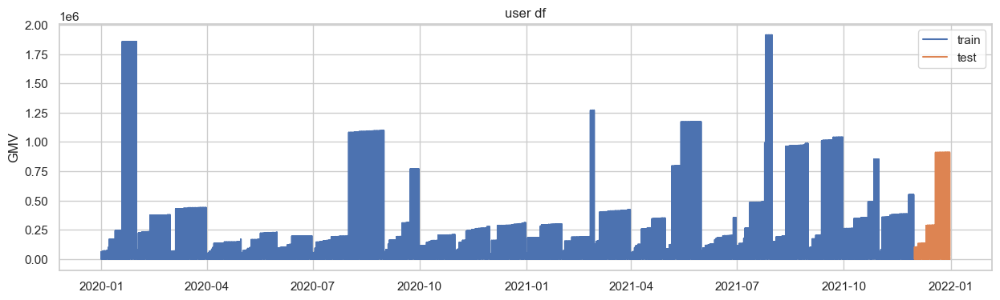

In [ ]:
plt.figure(figsize=(15,4))
plt.plot(Train_user.index.values, Train_user.gmv.values, label='train')
plt.plot(Test_user.index.values, Test_user.gmv.values, label='test')
plt.title('user df')
plt.ylabel('GMV')
plt.legend()
plt.show()

#### Yayay dataframe

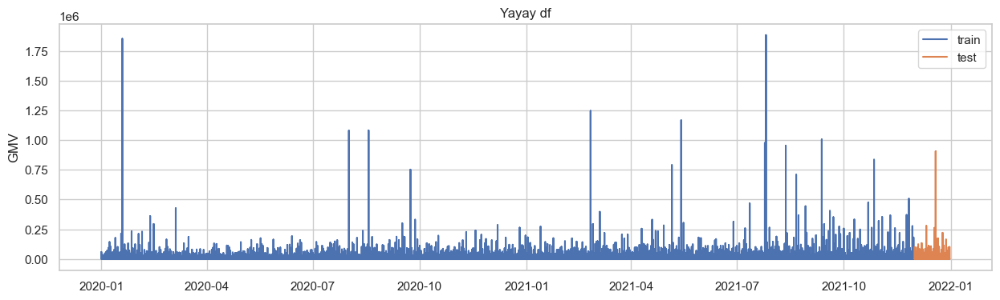

In [ ]:
plt.figure(figsize=(15,4))
plt.plot(Train_all.index.values, Train_all.gmv.values, label='train')
plt.plot(Test_all.index.values, Test_all.gmv.values, label='test')
plt.title('Yayay df')
plt.ylabel('GMV')
plt.legend()
plt.show()

### Test Train Split

In [ ]:
target_col = 'gmv'

In [ ]:
#train/test for user 
X_train_user = Train_user.drop(target_col, axis=1)
y_train_user = Train_user[target_col]
X_test_user = Test_user.drop(target_col, axis=1)
y_test_user = Test_user[target_col]

#train/test for all 
X_train_all = Train_all.drop(target_col, axis=1)
y_train_all = Train_all[target_col]
X_test_all = Test_all.drop(target_col, axis=1)
y_test_all = Test_all[target_col]

### Baseline Model

In [ ]:
# defining loss function
def calculate_smape(y_true, y_pred):
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2.0
    diff = np.abs(y_true - y_pred) / denominator
    
    # Handling the case where both y_true and y_pred are zero
    diff[denominator == 0] = 0.0
    
    return np.mean(diff) * 100

In [ ]:
def train_model(X, y, counts, regressor, num_splits=5):
    tscv = TimeSeriesSplit(n_splits=num_splits, max_train_size=counts*700, test_size=counts*31)
    
    rmse_scores = []
    smape_scores = []
    
    for train_index, test_index in tscv.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        regressor.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_test, y_test)], verbose=100)
    
        y_pred = regressor.predict(X_test)
        
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        smape = calculate_smape(y_test, y_pred)

        rmse_scores.append(rmse)
        smape_scores.append(smape)
        
        print(f'RMSE: {rmse}')
        print(f'Score for SMAPE: {smape}')
    
    avg_smape = np.mean(smape_scores)
    avg_rmse = np.mean(rmse_scores)

    print(f'Average RMSE across folds: {avg_rmse}')
    print(f'Average SMAPE across folds: {avg_smape}')

    return regressor

In [ ]:
xgb_reg = XGBRegressor(random_state=rand, n_jobs=-1)

#### baseline user model

In [ ]:
xgb_reg_user = train_model(X_train_user, y_train_user, uc, xgb_reg)

[0]	validation_0-rmse:10247.33037	validation_1-rmse:13521.13969
[99]	validation_0-rmse:7529.41958	validation_1-rmse:12098.11275
RMSE: 12098.112815404069
Score for SMAPE: 100.49013793836615
[0]	validation_0-rmse:10449.84294	validation_1-rmse:15029.16011
[99]	validation_0-rmse:7808.17042	validation_1-rmse:13227.25382
RMSE: 13227.253751149094
Score for SMAPE: 95.20522410979491
[0]	validation_0-rmse:10727.69861	validation_1-rmse:14608.83756
[99]	validation_0-rmse:7946.73900	validation_1-rmse:12901.43111
RMSE: 12901.431104846346
Score for SMAPE: 90.32098902613289
[0]	validation_0-rmse:10939.43110	validation_1-rmse:12810.10787
[99]	validation_0-rmse:8208.15376	validation_1-rmse:10869.04075
RMSE: 10869.040742231498
Score for SMAPE: 84.67156159350496
[0]	validation_0-rmse:11038.31654	validation_1-rmse:13079.04269
[99]	validation_0-rmse:8345.30601	validation_1-rmse:11260.26437
RMSE: 11260.264367200114
Score for SMAPE: 79.05155107453527
Average RMSE across folds: 12071.220556166223
Average SMAPE

In [ ]:
y_pred_user = xgb_reg_user.predict(X_test_user)
smape = calculate_smape(y_test_user, y_pred_user)
print(f'Score for user gmv: {smape}')

Score for user gmv: 75.14843333415348


#### Feature Selection with SHAP

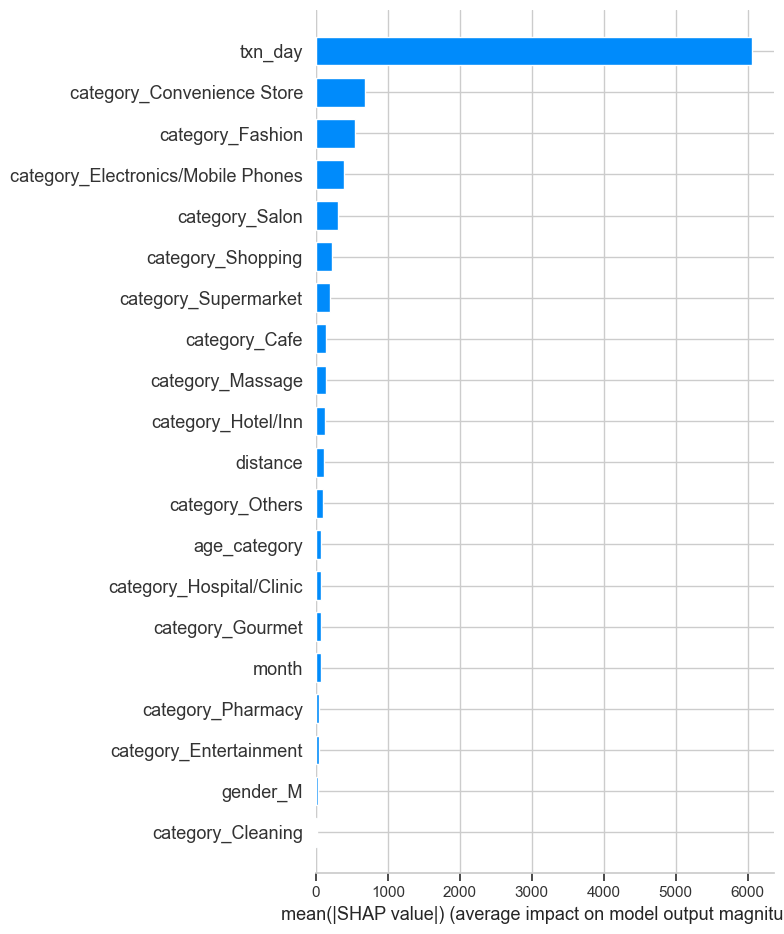

In [ ]:
explainer = shap.TreeExplainer(xgb_reg_user)
shap_values = explainer.shap_values(X_train_user)
shap.summary_plot(shap_values, X_train_user, plot_type="bar", feature_names=X_train_user.columns)

It seems the model is learning noise, this probably because most of transactions occur during the day an hardy at night and even if they do, it may be representing transactions for shopping or supermarket, so lets drop the `txn_day` column and try training the model again

In [ ]:
drop_txn=X_train_user.columns.drop(['txn_day'])

In [ ]:
xgb_reg_user = train_model(X_train_user[drop_txn], y_train_user, uc, xgb_reg)
y_pred_user = xgb_reg_user.predict(X_test_user[drop_txn])
smape = calculate_smape(y_test_user, y_pred_user)
print(f'Score for user gmv: {smape}')

[0]	validation_0-rmse:10407.30818	validation_1-rmse:13686.42305
[99]	validation_0-rmse:7569.08700	validation_1-rmse:11992.68491
RMSE: 11992.68499782533
Score for SMAPE: 100.77664362136036
[0]	validation_0-rmse:10605.98475	validation_1-rmse:15191.22120
[99]	validation_0-rmse:7962.53645	validation_1-rmse:13412.79906
RMSE: 13412.7991152321
Score for SMAPE: 95.60324245767006
[0]	validation_0-rmse:10880.91227	validation_1-rmse:14808.23973
[99]	validation_0-rmse:8001.64702	validation_1-rmse:12961.71291
RMSE: 12961.712931416696
Score for SMAPE: 90.66061216691858
[0]	validation_0-rmse:11106.11377	validation_1-rmse:13066.16362
[99]	validation_0-rmse:8322.51258	validation_1-rmse:10852.20265
RMSE: 10852.202610160399
Score for SMAPE: 85.08131852843997
[0]	validation_0-rmse:11202.38950	validation_1-rmse:13369.36306
[99]	validation_0-rmse:8383.53382	validation_1-rmse:11391.52002
RMSE: 11391.520001270539
Score for SMAPE: 79.39355368601329
Average RMSE across folds: 12122.183931181013
Average SMAPE ac

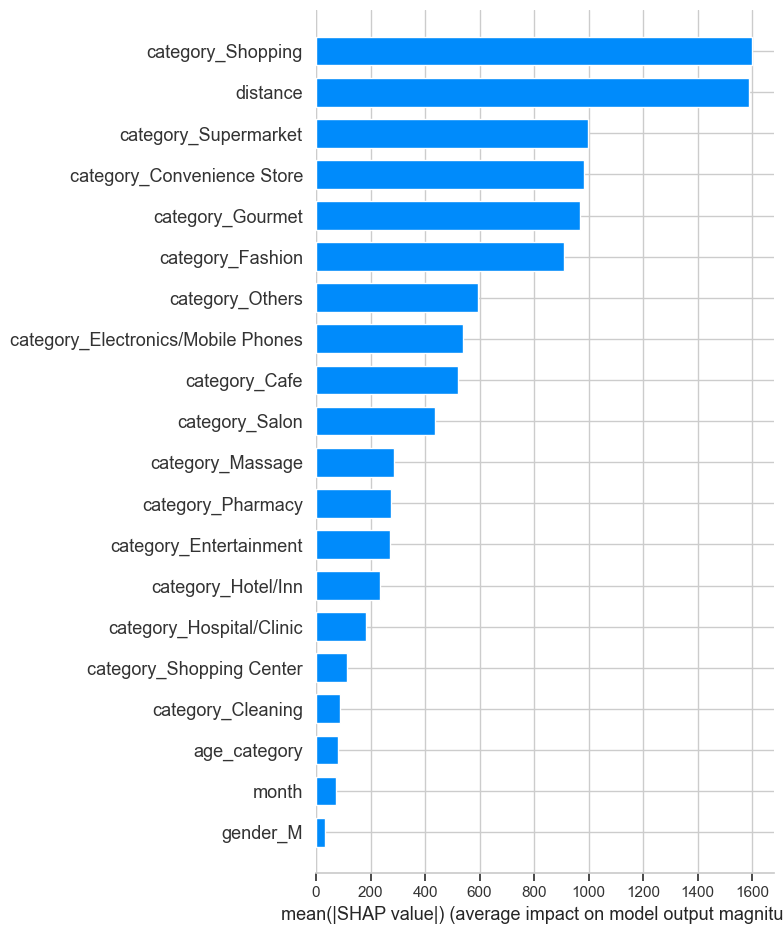

In [ ]:
explainer = shap.TreeExplainer(xgb_reg_user)
shap_values = explainer.shap_values(X_train_user[drop_txn])
shap.summary_plot(shap_values, X_train_user[drop_txn], plot_type="bar", feature_names=X_train_user[drop_txn].columns)

this seems to align with the real world, where gmv depends on categories

In [ ]:
mean_abs_shap_values = np.abs(shap_values).mean(axis=0)

In [ ]:
threshold = 10  # selecting values where 
selected_features_user = X_train_user[drop_txn].columns[mean_abs_shap_values > threshold]

In [ ]:
print(selected_features_user)

Index(['gender_F', 'gender_M', 'gender_Not Provided', 'category_Cafe',
       'category_Cleaning', 'category_Convenience Store',
       'category_Electronics/Mobile Phones', 'category_Entertainment',
       'category_Fashion', 'category_Gourmet', 'category_Hospital/Clinic',
       'category_Hotel/Inn', 'category_Massage', 'category_Others',
       'category_Pharmacy', 'category_Salon', 'category_Shopping',
       'category_Shopping Center', 'category_Supermarket', 'age_category',
       'distance', 'month'],
      dtype='object')


In [ ]:
xgb_reg_user = train_model(X_train_user[selected_features_user], y_train_user, uc, xgb_reg)
y_pred_user = xgb_reg_user.predict(X_test_user[selected_features_user])
smape = calculate_smape(y_test_user, y_pred_user)
print(f'Score for user gmv: {smape}')

[0]	validation_0-rmse:10407.30818	validation_1-rmse:13686.42305
[99]	validation_0-rmse:7485.06316	validation_1-rmse:11992.91994
RMSE: 11992.919813269373
Score for SMAPE: 100.85759301854004
[0]	validation_0-rmse:10605.98475	validation_1-rmse:15191.22120
[99]	validation_0-rmse:7833.25079	validation_1-rmse:13125.23527
RMSE: 13125.235259865498
Score for SMAPE: 95.5977520489431
[0]	validation_0-rmse:10880.91227	validation_1-rmse:14808.23973
[99]	validation_0-rmse:7960.29884	validation_1-rmse:12917.63714
RMSE: 12917.637154263093
Score for SMAPE: 90.67076176963488
[0]	validation_0-rmse:11106.11377	validation_1-rmse:13066.16362
[99]	validation_0-rmse:8304.84052	validation_1-rmse:10955.04944
RMSE: 10955.049406701586
Score for SMAPE: 85.10380166068785
[0]	validation_0-rmse:11202.38950	validation_1-rmse:13369.36306
[99]	validation_0-rmse:8330.08673	validation_1-rmse:11264.76220
RMSE: 11264.76224515406
Score for SMAPE: 79.35793187229834
Average RMSE across folds: 12051.12077585072
Average SMAPE ac

#### baseline Yayay model

In [ ]:
xgb_reg_all= train_model(X_train_all, y_train_all, tc, xgb_reg)

[0]	validation_0-rmse:3411.64782	validation_1-rmse:6803.47932
[99]	validation_0-rmse:2952.37715	validation_1-rmse:6736.70723
RMSE: 6736.707163260363
Score for SMAPE: 122.66069770533493
[0]	validation_0-rmse:3673.46367	validation_1-rmse:4977.11074
[99]	validation_0-rmse:3204.03086	validation_1-rmse:5003.89767
RMSE: 5003.897643107759
Score for SMAPE: 117.92186011036601
[0]	validation_0-rmse:3743.64783	validation_1-rmse:4924.67051
[99]	validation_0-rmse:3306.55116	validation_1-rmse:4811.05903
RMSE: 4811.059090474218
Score for SMAPE: 111.93718556424899
[0]	validation_0-rmse:3809.64408	validation_1-rmse:4578.85559
[99]	validation_0-rmse:3390.32758	validation_1-rmse:4508.67794
RMSE: 4508.677967313909
Score for SMAPE: 106.57772423992252
[0]	validation_0-rmse:3848.13280	validation_1-rmse:4374.85082
[99]	validation_0-rmse:3434.63763	validation_1-rmse:5405.31509
RMSE: 5405.315095643162
Score for SMAPE: 99.10709304098806
Average RMSE across folds: 5293.1313919598815
Average SMAPE across folds: 11

In [ ]:
y_pred = xgb_reg_all.predict(X_test_all)
smape = calculate_smape(y_test_all, y_pred)
print(f'Score for user gmv: {smape}')

Score for user gmv: 96.33673299259563


#### Feature Selection with SHAP

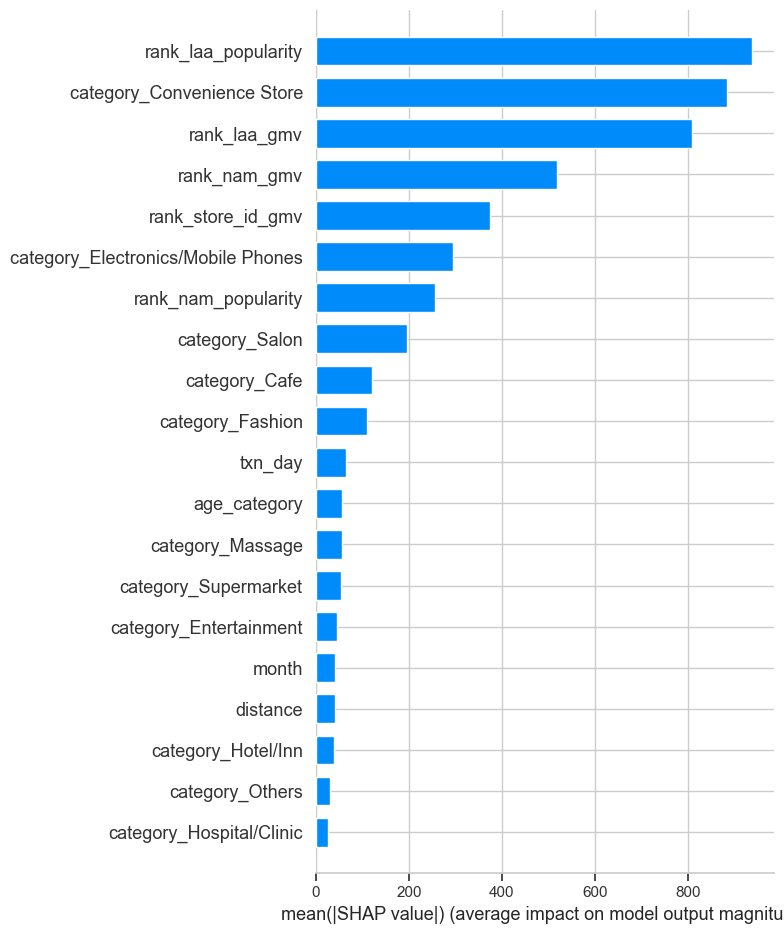

In [ ]:
explainer = shap.TreeExplainer(xgb_reg_all)
shap_values = explainer.shap_values(X_train_all,check_additivity=False)
shap.summary_plot(shap_values, X_train_all, plot_type="bar", feature_names=X_train_all.columns)

In [ ]:
mean_abs_shap_values = np.abs(shap_values).mean(axis=0)

In [ ]:
threshold = 25 
selected_features_all = X_train_all.columns[mean_abs_shap_values > threshold]

In [ ]:
print(selected_features_all)

Index(['rank_store_id_gmv', 'rank_laa_gmv', 'rank_nam_gmv',
       'rank_laa_popularity', 'rank_nam_popularity', 'category_Cafe',
       'category_Convenience Store', 'category_Electronics/Mobile Phones',
       'category_Entertainment', 'category_Fashion',
       'category_Hospital/Clinic', 'category_Hotel/Inn', 'category_Massage',
       'category_Others', 'category_Salon', 'category_Supermarket',
       'age_category', 'distance', 'txn_day', 'month'],
      dtype='object')


In [ ]:
xgb_reg_all= train_model(X_train_all[selected_features_all], y_train_all, tc, xgb_reg)
y_pred = xgb_reg_all.predict(X_test_all[selected_features_all])
smape = calculate_smape(y_test_all, y_pred)
print(f'Score for user gmv: {smape}')

[0]	validation_0-rmse:3411.64782	validation_1-rmse:6803.47932
[99]	validation_0-rmse:2956.50319	validation_1-rmse:6723.89461
RMSE: 6723.894539673181
Score for SMAPE: 122.98257079101025
[0]	validation_0-rmse:3673.46367	validation_1-rmse:4977.11074
[99]	validation_0-rmse:3241.64824	validation_1-rmse:4940.43572
RMSE: 4940.435700313703
Score for SMAPE: 117.8558377773687
[0]	validation_0-rmse:3743.64783	validation_1-rmse:4924.67051
[99]	validation_0-rmse:3319.72068	validation_1-rmse:4821.08838
RMSE: 4821.088345298256
Score for SMAPE: 112.05461013470853
[0]	validation_0-rmse:3809.64408	validation_1-rmse:4578.85559
[99]	validation_0-rmse:3392.16920	validation_1-rmse:4500.39427
RMSE: 4500.394276767594
Score for SMAPE: 106.861890325329
[0]	validation_0-rmse:3848.13280	validation_1-rmse:4404.96178
[99]	validation_0-rmse:3412.07567	validation_1-rmse:6066.77992
RMSE: 6066.77994605215
Score for SMAPE: 99.11365075807194
Average RMSE across folds: 5410.5185616209765
Average SMAPE across folds: 111.77

#### Hyperparameter Tuning

In [ ]:
params = {
    'n_estimators': [50, 100],  
    'learning_rate': [0.05, 0.1],  
    'max_depth': [3, 5, 7],  
    'reg_lambda': [0.1, 1, 10],  
    'reg_alpha': [0.1, 1, 10],  
    'subsample': [0.7, 0.8], 
    'colsample_bytree': [0.7, 0.8],  
    'gamma': [0, 1]  
}


In [ ]:
# creating an smape scorer
smape_scorer = make_scorer(calculate_smape, greater_is_better=False)

In [ ]:
def gridsearch(X, y, regressor, counts, num_splits=5):
    tscv = TimeSeriesSplit(n_splits=num_splits, max_train_size=counts*700, test_size=counts*31)
    gridcv = GridSearchCV(estimator=xgb_reg, param_grid=params,scoring=smape_scorer, n_jobs=-1, cv=tscv)
    gridcv = gridcv.fit(X, y)
    return gridcv

In [ ]:
gridcv_user = gridsearch(X_train_user, y_train_user, xgb_reg, uc)

In [ ]:
gridcv_all = gridsearch(X_train_all, y_train_all, xgb_reg, tc)

#### Best Params

In [ ]:
best_params_user = {'n_estimators':100, 'max_depth':5, 'reg_aplha':1} 

Let us check if these params are overfitting

In [ ]:
xgb_reg = XGBRegressor(random_state=rand ,n_jobs=-1 ,**best_params_user)
xgb_reg_user = train_model(X_train_user[selected_features_user], y_train_user, uc, regressor=xgb_reg)
y_pred_user = xgb_reg_user.predict(X_test_user[selected_features_user])
smape = calculate_smape(y_test_user, y_pred_user)
print(f'Score for user gmv: {smape}')

[0]	validation_0-rmse:10458.80258	validation_1-rmse:13737.45099
[99]	validation_0-rmse:8059.38254	validation_1-rmse:12021.33528
RMSE: 12021.335410336813
Score for SMAPE: 100.9380393265058
[0]	validation_0-rmse:10659.47519	validation_1-rmse:15244.70326
[99]	validation_0-rmse:8315.74293	validation_1-rmse:13152.31244
RMSE: 13152.312450419106
Score for SMAPE: 95.36352528653963
[0]	validation_0-rmse:10934.97268	validation_1-rmse:14862.28949
[99]	validation_0-rmse:8557.12496	validation_1-rmse:13071.43227
RMSE: 13071.432198391556
Score for SMAPE: 90.56060961621259
[0]	validation_0-rmse:11159.86352	validation_1-rmse:13132.35524
[99]	validation_0-rmse:8803.07332	validation_1-rmse:11059.77356
RMSE: 11059.773598672582
Score for SMAPE: 85.03939328355408
[0]	validation_0-rmse:11257.28292	validation_1-rmse:13444.81328
[99]	validation_0-rmse:8719.04631	validation_1-rmse:11179.54233
RMSE: 11179.54232439724
Score for SMAPE: 79.34034648112215
Average RMSE across folds: 12096.87919644346
Average SMAPE ac

In [ ]:
best_params_all = {'n_estimators':200, 'learning_rate':0.05, 'max_depth':5, 'reg_lambda':1, 'reg_alpha':0.1, 'subsample':0.8, 'colsample_bytree':0.8, 'gamma':2}

In [ ]:
xgb_reg = XGBRegressor(random_state=rand ,n_jobs=-1 ,**best_params_all)
xgb_reg_all= train_model(X_train_all[selected_features_all], y_train_all, tc, xgb_reg)
y_pred = xgb_reg_all.predict(X_test_all[selected_features_all])
smape = calculate_smape(y_test_all, y_pred)
print(f'Score for user gmv: {smape}')

[0]	validation_0-rmse:3552.44857	validation_1-rmse:6874.07330
[100]	validation_0-rmse:3116.99440	validation_1-rmse:6675.33444
[199]	validation_0-rmse:3067.18535	validation_1-rmse:6682.22047
RMSE: 6682.220566865383
Score for SMAPE: 122.52673543476176
[0]	validation_0-rmse:3805.58436	validation_1-rmse:5078.43320
[100]	validation_0-rmse:3405.53299	validation_1-rmse:4824.32641
[199]	validation_0-rmse:3359.87239	validation_1-rmse:4831.54508
RMSE: 4831.54510503696
Score for SMAPE: 117.35191827877674
[0]	validation_0-rmse:3880.69587	validation_1-rmse:5029.90177
[100]	validation_0-rmse:3496.05589	validation_1-rmse:4811.40845
[199]	validation_0-rmse:3442.90037	validation_1-rmse:4843.58422
RMSE: 4843.584245353129
Score for SMAPE: 111.78949064937405
[0]	validation_0-rmse:3944.70270	validation_1-rmse:4718.78597
[100]	validation_0-rmse:3571.85377	validation_1-rmse:4375.20390
[199]	validation_0-rmse:3513.58715	validation_1-rmse:4398.64357
RMSE: 4398.643587250021
Score for SMAPE: 106.61632201200051
[

These seem to be performing about the same with less overfitting

#### Exploring Model Limitations

Now that we have selected the features and tuned the parameter Let us try to understand the model limitation and quantify uncertainty

In [ ]:
selected_features_user= ['gender_F', 'gender_M', 'gender_Not Provided', 'category_Cafe',
       'category_Cleaning', 'category_Convenience Store',
       'category_Electronics/Mobile Phones', 'category_Entertainment',
       'category_Fashion', 'category_Gourmet', 'category_Hospital/Clinic',
       'category_Hotel/Inn', 'category_Massage', 'category_Others',
       'category_Pharmacy', 'category_Salon', 'category_Shopping',
       'category_Shopping Center', 'category_Supermarket', 'age_category',
       'distance', 'month']

best_params_user = {'n_estimators':100, 'max_depth':5, 'reg_aplha':1}

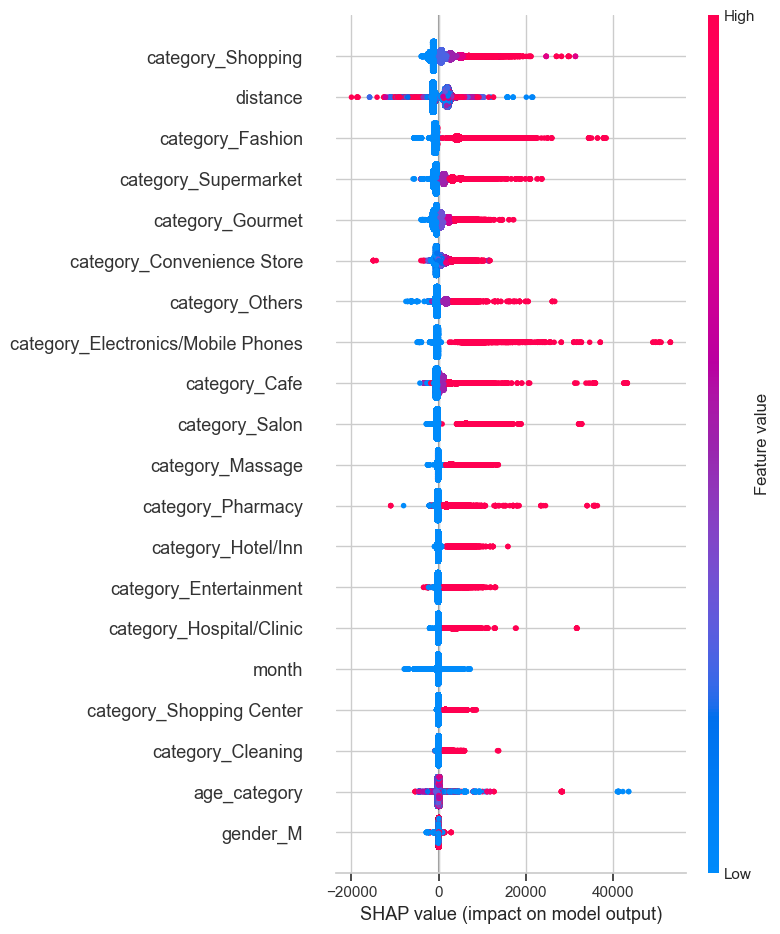

In [ ]:
xgb_reg_user = XGBRegressor(random_state=rand ,n_jobs=-1 ,**best_params_user)
xgb_reg_user.fit(X_train_user[selected_features_user], y_train_user)
explainer = shap.Explainer(xgb_reg_user)
shap_values = explainer.shap_values(X_test_user[selected_features_user])
shap.summary_plot(shap_values, X_test_user[selected_features_user])

higher values of different categories seem to have higher impact on the output which make sense in general, with occasional outliers, distance seem to have high variabilty here for low as well as high values.

In [ ]:
selected_features_all= ['rank_store_id_gmv', 'rank_laa_gmv', 'rank_nam_gmv',
       'rank_laa_popularity', 'rank_nam_popularity', 'category_Cafe',
       'category_Convenience Store', 'category_Electronics/Mobile Phones',
       'category_Entertainment', 'category_Fashion',
       'category_Hospital/Clinic', 'category_Hotel/Inn', 'category_Massage',
       'category_Others', 'category_Salon', 'category_Supermarket',
       'age_category', 'distance', 'txn_day', 'month']

best_params_all = best_params_all = {'n_estimators':200, 'learning_rate':0.05, 'max_depth':5, 
                                     'reg_lambda':1,'reg_alpha':0.1, 'subsample':0.8, 'colsample_bytree':0.8, 'gamma':2}

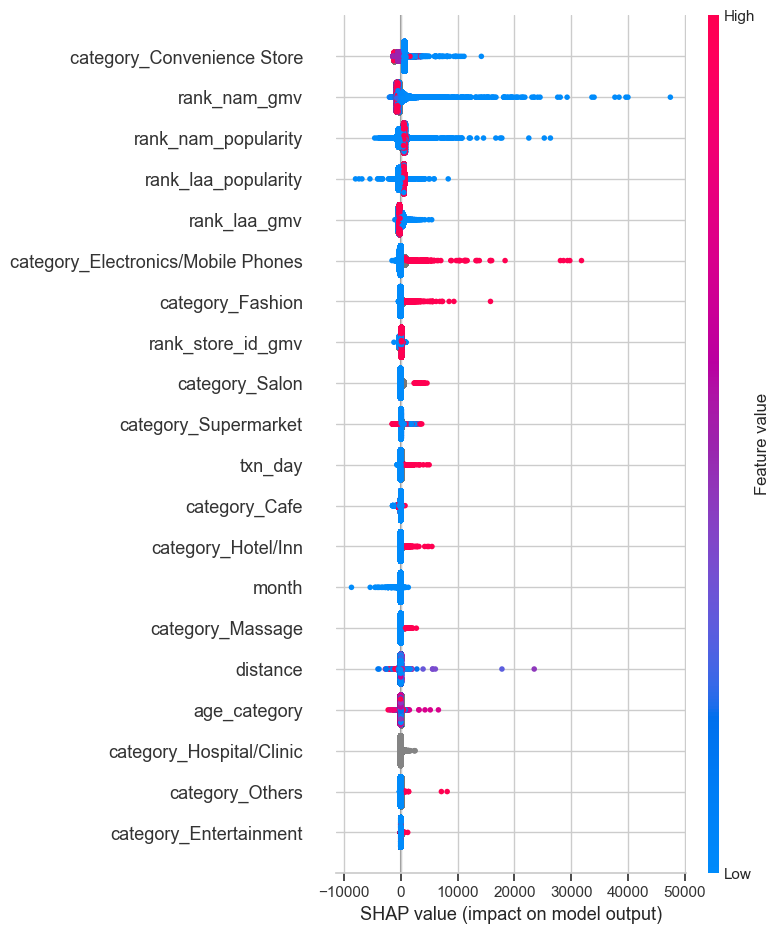

In [ ]:
xgb_reg_all = XGBRegressor(random_state=rand ,n_jobs=-1 ,**best_params_all)
xgb_reg_all.fit(X_train_all[selected_features_all], y_train_all)
explainer = shap.Explainer(xgb_reg_all)
shap_values = explainer.shap_values(X_test_all[selected_features_all])
shap.summary_plot(shap_values, X_test_all[selected_features_all])

lower ranks for nam and laa in gmv and popularity seem to have high impact on gmv in general, meaning peaple usually shop at popular store and in their local area and district also categories that seem to have a high impact are electronics like mobile phone etc.We also see some high value in distance seem to have a low impact on output model, these could be cases where a user is may traveling on that day and made a small purchase on its way.

based on this we will need to quantify the output interval for our prediction

#### Quantifying Uncertainity

There are two types of UQ algorithms:
1. Intrinsic
2. Extrinsic

and they operate on two levels:
1. Data
2. Model

For our case we will use conformal prediction with mapie, which is a extrensic  UQ algorithm.

It leverages residuals of the validation datasets across multiple cross-validation folds, in addition to several perturbed models generated during the cross-validation, to produce the confidence intervals.

We will be forecasting for the month of january,we need to understand where the median and outliers lie within the previous 3 months let us create a df and include the 2.5%, 50%,75% and 97.5% percentiles.

- why previous 3 months? as per the gmv graphs above we saw there weren't any major spikes in the last 3 months.We are assuming the the user behaviour remains same for this month as well, In real life we would typically discuss with the business teams on how many categories would be sold and other intrinsic factors

In [ ]:
# visualizing true values only
jan_users = df_user[(df_user.index.day==31) & (df_user.index.month.isin([10,11,12]))][selected_features_user]
jan_users.describe(percentiles=[.025,.5,.75,.975]).transpose()

,count,mean,std,min,2.5%,50%,75%,97.5%,max
category_Cafe,38168.0,0.624686,0.912825,0.0,0.0,0.000000,1.0000,3.000000,7.000
category_Cleaning,38168.0,0.082844,0.295025,0.0,0.0,0.000000,0.0000,1.000000,3.000
category_Convenience Store,38168.0,2.818853,2.763466,0.0,0.0,2.500000,5.0000,9.000000,16.000
category_Electronics/Mobile Phones,38168.0,0.087848,0.303793,0.0,0.0,0.000000,0.0000,1.000000,3.000
category_Entertainment,38168.0,0.181959,0.462136,0.0,0.0,0.000000,0.0000,2.000000,4.000
category_Fashion,38168.0,0.262497,0.611139,0.0,0.0,0.000000,0.0000,2.000000,6.000
category_Gourmet,38168.0,1.116799,1.355133,0.0,0.0,1.000000,2.0000,4.000000,12.000
category_Hospital/Clinic,38168.0,0.082006,0.294637,0.0,0.0,0.000000,0.0000,1.000000,3.000
category_Hotel/Inn,38168.0,0.085019,0.295250,0.0,0.0,0.000000,0.0000,1.000000,3.000
category_Massage,38168.0,0.115227,0.356812,0.0,0.0,0.000000,0.0000,1.000000,4.000


the spend seem to be constant mostly beacause of items purchased are not in high value categories

In [ ]:
gender_cols=X_train_all.filter(regex=r'^gender_').columns.to_list()
df_all[(df_all[gender_cols].any(axis=1)) & (df_all.index.month.isin([10,11,12]))][selected_features_all].describe(percentiles=[.025,.5,.75,.975]).transpose()

,count,mean,std,min,2.5%,50%,75%,97.5%,max
rank_store_id_gmv,492842.0,4447.154471,4968.341062,1.0,1.0,1.0,9999.000000,9999.000000,9999.0000
rank_laa_gmv,492842.0,4463.009449,4954.398304,1.0,1.0,73.0,9999.000000,9999.000000,9999.0000
rank_nam_gmv,492842.0,4596.457522,4842.899933,1.0,8.0,690.0,9999.000000,9999.000000,9999.0000
rank_laa_popularity,492842.0,4449.463069,4966.276726,1.0,1.0,13.0,9999.000000,9999.000000,9999.0000
rank_nam_popularity,492842.0,4454.833561,4961.473155,1.0,2.0,28.0,9999.000000,9999.000000,9999.0000
category_Cafe,492842.0,0.073021,0.264204,0.0,0.0,0.0,0.000000,1.000000,4.0000
category_Convenience Store,492842.0,0.409669,0.733242,0.0,0.0,0.0,1.000000,2.000000,14.0000
category_Electronics/Mobile Phones,492842.0,0.010159,0.101107,0.0,0.0,0.0,0.000000,0.000000,2.0000
category_Entertainment,492842.0,0.021755,0.151171,0.0,0.0,0.0,0.000000,0.000000,4.0000
category_Fashion,492842.0,0.030740,0.176127,0.0,0.0,0.0,0.000000,1.000000,3.0000


For predicting values in future(jan 2022) we would need to figure out how different values and interactions of features seem to impact the output variabilty. One way by which we can achieve this is to perform **senstivity analysis** and understand the **elementary effect** of the features and based on that quantifications get **prediction intervals** for each of our predictions using mapie.

For senstivity analysis can define a morris problem and understand the elementary effect of categories and but that would take up a lot time as we would need to define.

1. A morris problem
2. then, generate morris sample
3. Define a lookback function that could find the closest sample for each user and user-store combinations and compute a function to get their output and then solve the moris problem.
4. After solving we can examine the mu_star (overall influence of categories and across all tested scenarios) and sigma(variability in outbut due interaction effect of features) for each categotories and distance variable
5. based on this we quantify mu_star alpha(size of prediction interval) and select the method 'plus', 'base', 'minmax' based on to quantify it.

but here we will consider the prediction interval between 68%-95% and method as minmax to account for the interactions 

but lets first create a dataframe with jan 2022 for users and yayay as a whole

In [ ]:
stores_df = pd.read_csv('stores.csv')
users_df = pd.read_csv('users.csv')
df = pd.read_csv('transactions.csv', parse_dates=['event_occurrence'])

df = preprocess_data(df, stores_df, users_df)

df = calculate_travel_distances(df)

# calculate store ranks and popularilty
store_ranks_gmv = calculate_store_ranks_gmv(df)
store_popularity_user = calculate_store_ranks_popularity(df)
df['year_month'] = df['event_occurrence'].dt.to_period('M')
df = pd.merge(df, store_ranks_gmv, on=['store_id', 'laa', 'nam', 'year_month'], how='left')
df = pd.merge(df, store_popularity_user, on=['store_id', 'laa', 'nam', 'year_month'], how='left')

# Generate new dates for jan2022
date_range_df = pd.DataFrame({'event_occurrence': pd.date_range(start='2022-01-01', end='2022-01-31', freq='D')})
#concatenate new dates to df
df = pd.concat([df, date_range_df], ignore_index=True)

#shift populaity to next month to avoid data leak
columns_to_shift = df.filter(regex=r'^rank_.*').columns
df = shift_columns_by_month(df, columns_to_shift)

In [ ]:
df_user = aggregate_user_data(df)
df_all = aggregate_yayay_data(df)

In [ ]:
uc = df_all['user_id'].nunique()  # lenght of user in dataframe
tc = df_all['event_occurrence'].value_counts().max()  # max number transactions on yay

target_col= 'gmv'

df_user = df_user.set_index('event_occurrence').sort_index()
df_all = df_all.set_index('event_occurrence').sort_index()

# savinf userid for predictions
uid = df_user[df_user.index =='2021-12-31']['user_id']

# supposing categories remain the same
df_user.filter(regex=r'^category_'|r'^gender_')[df_user.index >'2021-12-31']=df_user.filter(regex=r'^category_'|r'^gender_').shift(31 * uc)[df_user.index >'2021-12-31']
df_all.filter(regex=r'^category_')[df_all.index >'2021-12-31']=df_all.filter(regex=r'^category_').shift(31 * tc)[df_all.index >'2021-12-31']

#dropping user_id and store_id
df_user = df_user.drop('user_id',axis=1)
df_all = df_all.drop(['user_id','store_id'],axis=1)

# 731 days in train, 31 days in test for each user
Train_user = df_user.iloc[:-31 * uc]
Test_user = df_user.iloc[-31 * uc:]

# 731 days in train, 31 days in test for each transaction
Train_all = df_all.iloc[:-31 * tc]
Test_all = df_all.iloc[-31 * tc:]

# Now we will using whole training data for user dataframe
X_train_user = df_user.drop(target_col, axis=1)
y_train_user = df_user[target_col]

X_test_user = X_test_user.drop(target_col, axis=1)

# Now we will using whole training data for user dataframe
X_train_all = Train_all.drop(target_col, axis=1)
y_train_all = Train_all[target_col]

X_test_all = Train_all.drop(target_col, axis=1)

now we will proceed with MapieRegressor to give us prediction intervals.We have chosen 0.05 and 0.32 (ie. how much the prediction can vary in 95 and 68 percentile based on extrinsic variables).

In [ ]:
selected_features_user= ['gender_F', 'gender_M', 'gender_Not Provided', 'category_Cafe',
       'category_Cleaning', 'category_Convenience Store',
       'category_Electronics/Mobile Phones', 'category_Entertainment',
       'category_Fashion', 'category_Gourmet', 'category_Hospital/Clinic',
       'category_Hotel/Inn', 'category_Massage', 'category_Others',
       'category_Pharmacy', 'category_Salon', 'category_Shopping',
       'category_Shopping Center', 'category_Supermarket', 'age_category',
       'distance', 'month']

best_params_user = {'n_estimators':100, 'max_depth':5, 'reg_aplha':1}

In [ ]:
xgb_reg_user = XGBRegressor(random_state=rand ,n_jobs=-1 ,**best_params_user)
xgb_mapie_reg_user = MapieRegressor(xgb_reg_user, method="minmax")
xgb_mapie_reg_user = xgb_mapie_reg_user.fit(Train_user[selected_features_user], y_train_user)

alpha = [0.05, 0.32]
y_mapie_pred_user, y_mapie_pis_user = xgb_mapie_reg_user.predict(X_test_user[selected_features_user], alpha=alpha)

coverage score specifies the probability that the true outcome is covered by the prediction region.

In [ ]:
coverage_score_l_user = [
    regression_coverage_score(y_test, y_mapie_pis_user[:, 0, i], y_mapie_pis_user[:, 1, i])
    for i, _ in enumerate(alpha)
]

print(coverage_score_l_user)

[0.9629120879120879, 0.7461080586080586]


so there is a 96% probability that actual prediction lie in upper lower bound of 98 percentie ditribution covered in the prediction interval and 74% probability for 68 percentile distribution

In [ ]:
preds_mapie_df_user = pd.DataFrame({ 'y_pred': y_mapie_pred_user,
                               'C0.68_lb':y_mapie_pis_user[:, 0, 1],
                               'C0.68_ub':y_mapie_pis_user[:, 1, 1],
                               'C0.95_lb':y_mapie_pis_user[:, 0, 0],
                               'C0.95_ub':y_mapie_pis_user[:, 1, 0]})
preds_mapie_df = preds_mapie_df[-1*uc:]
preds_mapie_df['uid'] = uid

# last day represents the gmv for users during month of july
preds_mapie_df[-1*uc:].reset_index().set_index('id').to_csv('user_pred.csv')

Now for prediction for Yayay as a whole

In [ ]:
selected_features_all= ['rank_store_id_gmv', 'rank_laa_gmv', 'rank_nam_gmv',
       'rank_laa_popularity', 'rank_nam_popularity', 'category_Cafe',
       'category_Convenience Store', 'category_Electronics/Mobile Phones',
       'category_Entertainment', 'category_Fashion',
       'category_Hospital/Clinic', 'category_Hotel/Inn', 'category_Massage',
       'category_Others', 'category_Salon', 'category_Supermarket',
       'age_category', 'distance', 'txn_day', 'month']

best_params_all = best_params_all = {'n_estimators':200, 'learning_rate':0.05, 'max_depth':5, 
                                     'reg_lambda':1,'reg_alpha':0.1, 'subsample':0.8, 'colsample_bytree':0.8, 'gamma':2}

In [ ]:
xgb_reg_all = XGBRegressor(random_state=rand ,n_jobs=-1 ,**best_params_all)
xgb_mapie_reg_all = MapieRegressor(xgb_reg_all, method="minmax")
xgb_mapie_reg_user = xgb_mapie_reg_user.fit(X_train_all[selected_features_all], y_train_all)

alpha = [0.05, 0.32]
y_mapie_pred_all, y_mapie_pis_all = mapie_reg.predict(X_test_all[selected_features_all], alpha=alpha)

In [ ]:
coverage_score_l = [
    regression_coverage_score(y_test_all, y_mapie_pis_all[:, 0, i], y_mapie_pis_all[:, 1, i])
    for i, _ in enumerate(alpha)
]

print(coverage_score_l)

[0.954912879120879, 0.7531085576080886]


In [ ]:
preds_mapie_df_all = pd.DataFrame({'y_pred': y_mapie_pred_all,
                               'C0.68_lb':y_mapie_pis_all[:, 0, 1],
                               'C0.68_ub':y_mapie_pis_all[:, 1, 1],
                               'C0.95_lb':y_mapie_pis_all[:, 0, 0],
                               'C0.95_ub':y_mapie_pis_all[:, 1, 0]})

##daily GMV for jan 2022 for all transactions at yayay
preds_mapie_df.cumsum().groupby('event_occurrence').max().to_csv('all_preds.csv')

#### TLDR

- First we performed an EDA on feature
- Based on the EDA we engineered some features, which included distance travelled by user, rank and popularity of stores amoung different demographies and geeographies.After creating the features we encoded categorical variables.
- After this we performed aggregation to create df assuming that we need to calulate gmv on montly basis and forecasting it for user and Yayay
- After preparing the dataframe we used an xgboost model with timeseries split to access the models performace
- After running the model we inspected our model with shap to check feature importance, we removed all noise and less impactful features
- After feature selection we performed hyperparameter tuning to the find best parameters.
- We retrained the model with mapie to get the predicition intervals in the 68-98 percentile with lower and upper bounds.
- We then prepared a df with imputed the mising values and predicted the future values for jan 2022

#### Potential Improvements

- We can use better lag based features to capture spend volatility among categories, as we saw our model was susceptible to this.
- Try better models like Bi-LSTM,GRU to capture long term dependencies and embeddings between user and categories.
- combining models that can capture sparse relations like randomforest with boosting model could also be a viable option
- Understand the problem more from a business perspective and use better metrics to evaluate like quantile loss etc.
- use senstivity analysis methods like sobol and morris to quantify uncertainity better and find better prediction intervals.We can also experiment with quantile regression functions